<a href="https://colab.research.google.com/github/chirucodes/aiml/blob/main/ImageCaptiongenerator_Transformer_Resnet50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#from google.colab import drive
#drive.mount('/content/gdrive')

# New Section

To download Flickr Data set and unzip it . It has 8000 images and we will be using 5000 for training , 1000 validation and 2000 for testing 

In [ ]:
!rm -rf Flickr8k_Dataset.zip
!rm -rf Flickr8k_text.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip -O Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip -O Flickr8k_text.zip
!unzip Flickr8k_Dataset.zip
!unzip Flickr8k_text.zip

Streaming output truncated to the last 5000 lines.
  inflating: __MACOSX/Flicker8k_Dataset/._3429391520_930b153f94.jpg  
  inflating: Flicker8k_Dataset/3429465163_fb8ac7ce7f.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429465163_fb8ac7ce7f.jpg  
  inflating: Flicker8k_Dataset/3429581486_4556471d1a.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429581486_4556471d1a.jpg  
  inflating: Flicker8k_Dataset/3429641260_2f035c1813.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429641260_2f035c1813.jpg  
  inflating: Flicker8k_Dataset/3429956016_3c7e3096c2.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3429956016_3c7e3096c2.jpg  
  inflating: Flicker8k_Dataset/3430100177_5864bf1e73.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430100177_5864bf1e73.jpg  
  inflating: Flicker8k_Dataset/3430287726_94a1825bbf.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430287726_94a1825bbf.jpg  
  inflating: Flicker8k_Dataset/3430526230_234b3550f6.jpg  
  inflating: __MACOSX/Flicker8k_Dataset/._3430

In [ ]:
#Importing all libraries for Keras , Tensorflow and Resnet50

In [ ]:
import string
import numpy as np
import pandas as pd 
from numpy import array
from PIL import Image
import pickle

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings 
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from tqdm import tqdm

from nltk.translate.bleu_score import sentence_bleu

from keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from keras.layers.merge import add
from keras.callbacks import ModelCheckpoint
from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.applications.resnet50 import ResNet50
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
image_path = "/content/Flicker8k_Dataset"
dir_Flickr_text = "/content/Flickr8k.token.txt"

jpgs = os.listdir(image_path)
print("Total Images in Dataset = {}".format(len(jpgs)))

Total Images in Dataset = 8091


In [ ]:
#check Image file name to Caption combination derived from the Flick8 dataset

In [ ]:
file = open(dir_Flickr_text,'r')
text = file.read()
file.close()

datatxt = []
for line in text.split('\n'):
    col = line.split('\t')
    if len(col) == 1:
        continue
    w = col[0].split("#")
    datatxt.append(w + [col[1].lower()])

data = pd.DataFrame(datatxt,columns=["filename","index","caption"])
data = data.reindex(columns =['index','filename','caption'])
data = data[data['filename'] != '2258277193_586949ec62.jpg.1']


uni_filenames = np.unique(data.filename.values)
data.head()

,index,filename,caption
0,0,1000268201_693b08cb0e.jpg,a child in a pink dress is climbing up a set o...
1,1,1000268201_693b08cb0e.jpg,a girl going into a wooden building .
2,2,1000268201_693b08cb0e.jpg,a little girl climbing into a wooden playhouse .
3,3,1000268201_693b08cb0e.jpg,a little girl climbing the stairs to her playh...
4,4,1000268201_693b08cb0e.jpg,a little girl in a pink dress going into a woo...


Print some images along with captions to check the Flickr Data that was imported

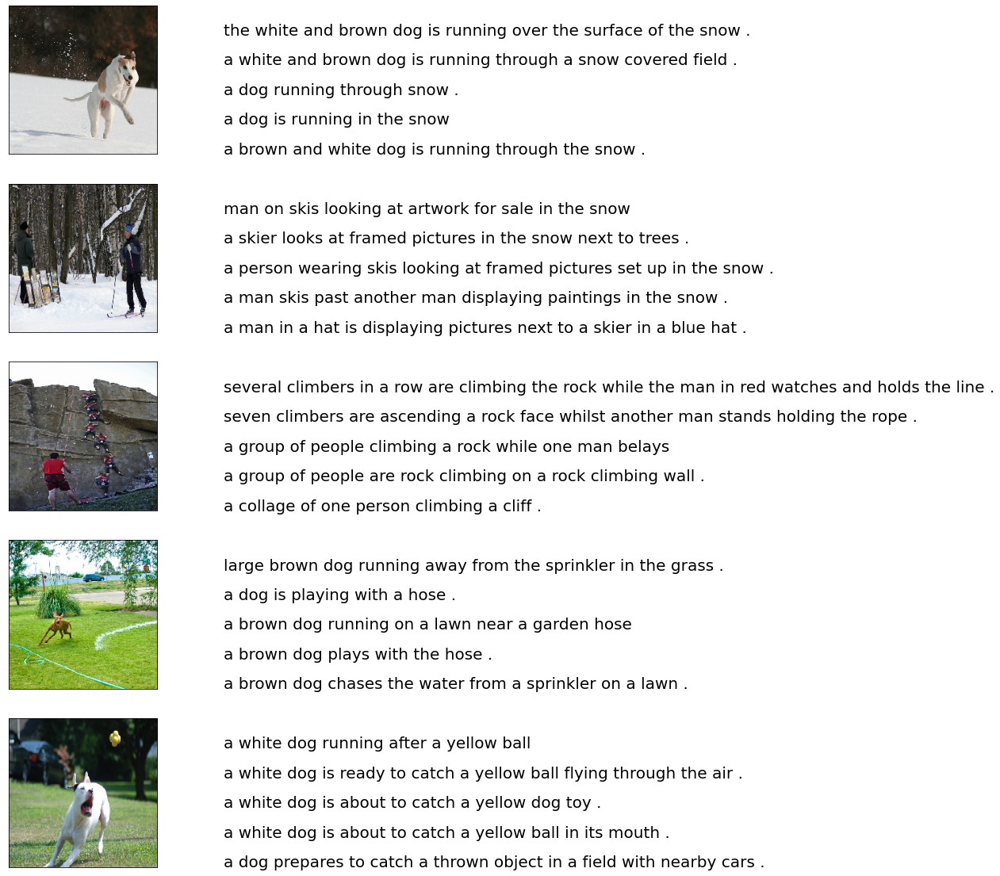

In [ ]:
from keras.preprocessing.image import load_img, img_to_array

npic = 5
npix = 224
target_size = (npix,npix,3)

count = 1
fig = plt.figure(figsize=(10,20))
for jpgfnm in uni_filenames[10:15]:
    filename = image_path + '/' + jpgfnm
    captions = list(data["caption"].loc[data["filename"]==jpgfnm].values)
    image_load = load_img(filename, target_size=target_size)
    
    ax = fig.add_subplot(npic,2,count,xticks=[],yticks=[])
    ax.imshow(image_load)
    count += 1
    
    ax = fig.add_subplot(npic,2,count)
    plt.axis('off')
    ax.plot()
    ax.set_xlim(0,1)
    ax.set_ylim(0,len(captions))
    for i, caption in enumerate(captions):
        ax.text(0,i,caption,fontsize=20)
    count += 1
plt.show()

In [ ]:
# Get all the words available i the captions by splitting the sentences

In [ ]:
vocabulary = []
for txt in data.caption.values:
    vocabulary.extend(txt.split())
print('Vocabulary Size: %d' % len(set(vocabulary)))

Vocabulary Size: 8918


In [ ]:
# crearting a list of Image file names and captions

In [ ]:
img = data["filename"].tolist()
caption = data["caption"].tolist()

In [ ]:
print(f"len(img) : {len(img)}")
print(f"len(caption) : {len(caption)}")

len(img) : 40455
len(caption) : 40455


In [ ]:
""" Removing punctuations , Single characters , Numeric values from the word/Vocabulary , having them would make increase the probability of such words over others due to repetitive usage
giving undesired results """
# To remove punctuations
def remove_punctuation(text_original):
    text_no_punctuation = text_original.translate(string.punctuation)
    return(text_no_punctuation)

# To remove single characters
def remove_single_character(text):
    text_len_more_than1 = ""
    for word in text.split():
        if len(word) > 1:
            text_len_more_than1 += " " + word
    return(text_len_more_than1)

# To remove numeric values
def remove_numeric(text):
    text_no_numeric = ""
    for word in text.split():
        isalpha = word.isalpha()
        if isalpha:
            text_no_numeric += " " + word
    return(text_no_numeric)

In [ ]:
""" Cleaning up the original text without punctuations, single characters and numeric values """

' Cleaning up the original text without punctuations, single characters and numeric values '

In [ ]:
def text_clean(text_original):
    text = remove_punctuation(text_original)
    text = remove_single_character(text)
    text = remove_numeric(text)
    return(text)
    
for i, caption in enumerate(data.caption.values):
    newcaption = text_clean(caption)
    data["caption"].iloc[i] = newcaption

In [ ]:
#building clean vocabulary
clean_vocabulary = []
for txt in data.caption.values:
    clean_vocabulary.extend(txt.split())
print('Clean Vocabulary Size: %d' % len(set(clean_vocabulary)))

Clean Vocabulary Size: 8357


In [ ]:
# adding <start> and <end> tags to sentences to identify the start and end of the sentences while looping through words in sentence
PATH = "/content/Flicker8k_Dataset/"
all_captions = []

for caption  in data["caption"].astype(str):
    caption = '<start> ' + caption+ ' <end>'
    all_captions.append(caption)
all_captions[:10]

['<start>  child in pink dress is climbing up set of stairs in an entry way <end>',
 '<start>  girl going into wooden building <end>',
 '<start>  little girl climbing into wooden playhouse <end>',
 '<start>  little girl climbing the stairs to her playhouse <end>',
 '<start>  little girl in pink dress going into wooden cabin <end>',
 '<start>  black dog and spotted dog are fighting <end>',
 '<start>  black dog and dog playing with each other on the road <end>',
 '<start>  black dog and white dog with brown spots are staring at each other in the street <end>',
 '<start>  two dogs of different breeds looking at each other on the road <end>',
 '<start>  two dogs on pavement moving toward each other <end>']

In [ ]:
#building path to read each image from the content downloaded
all_img_name_vector = []

for annot in data["filename"]:
    full_image_path = PATH + annot

    all_img_name_vector.append(full_image_path)
all_img_name_vector[:10]

['/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1000268201_693b08cb0e.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg',
 '/content/Flicker8k_Dataset/1001773457_577c3a7d70.jpg']

In [ ]:
print(f"len(all_img_name_vector) : {len(all_img_name_vector)}")
print(f"len(all_captions) : {len(all_captions)}")

len(all_img_name_vector) : 40455
len(all_captions) : 40455


In [ ]:
def data_limiter(num,total_captions,all_img_name_vector):
  train_captions, img_name_vector = shuffle(total_captions,all_img_name_vector,random_state=1)
  train_captions = train_captions[:num]
  img_name_vector = img_name_vector[:num]
  return train_captions,img_name_vector

In [ ]:
train_captions,img_name_vector = data_limiter(40000,all_captions,all_img_name_vector)

In [ ]:
print(f"len(all_img_name_vector) : {len(img_name_vector)}")
print(f"len(all_captions) : {len(train_captions)}")

len(all_img_name_vector) : 40000
len(all_captions) : 40000


In [ ]:
#Loading an image with (224,224,3) for passing to Encoder Resnet50
def load_image(image_path):
    img = tf.io.read_file(image_path)
    img = tf.image.decode_jpeg(img, channels=3)
    img = tf.image.resize(img, (224, 224))
    return img, image_path

In [ ]:
image_model_ic = tf.keras.applications.InceptionV3(include_top=False,weights='imagenet')
#Using Pretrained Resnet50 as encoder and taking Input size of (224,224,3)
image_model = ResNet50(include_top=False,weights='imagenet',input_shape=(224, 224,3),pooling="avg")
new_input = image_model.input
hidden_layer = image_model.layers[-2].output

image_features_extract_model = tf.keras.Model(new_input, hidden_layer)

94781440/94765736 [==============================] - 1s 0us/step


In [ ]:
image_model_ic.summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

In [ ]:
image_model.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                           

In [ ]:
# Get unique images
encode_train = sorted(set(img_name_vector))

# Batch size 16
image_dataset = tf.data.Dataset.from_tensor_slices(encode_train)
image_dataset = image_dataset.map(
  load_image, num_parallel_calls=tf.data.experimental.AUTOTUNE).batch(16)
#Building Image feature vector using Resnet50 Encoder
for img, path in tqdm(image_dataset):
  batch_features = image_features_extract_model(img)
  # converting image from Resnet (16,7,7,2048) to (16,49,2048)
  batch_features = tf.reshape(batch_features,
                              (batch_features.shape[0], -1, batch_features.shape[3]))

  for bf, p in zip(batch_features, path):
    path_of_feature = p.numpy().decode("utf-8")
    np.save(path_of_feature, bf.numpy())

100%|██████████| 506/506 [01:22<00:00,  6.17it/s]


In [ ]:
#temp code
for img1, path1 in tqdm(image_dataset):
  batch_features1 = image_features_extract_model(img1)
  print("shape",batch_features1.shape)
  print("batch_features.shape[0]",batch_features1.shape[0])
  print("batch_features.shape[1]",batch_features1.shape[1])
  print("batch_features.shape[2]",batch_features1.shape[2])
  print("batch_features.shape[3]",batch_features1.shape[3])
  batch_features2 = tf.reshape(batch_features1,
                              (batch_features1.shape[0], -1, batch_features1.shape[3]))
  print("shape",batch_features2.shape)
  print("batch_features2.shape[0]",batch_features2.shape[0])
  print("batch_features2.shape[1]",batch_features2.shape[1])
  print("batch_features2.shape[2]",batch_features2.shape[2])
  #print("batch_features2.shape[3]",batch_features2.shape[3])
  break

  0%|          | 0/506 [00:00<?, ?it/s]

shape (16, 7, 7, 2048)
batch_features.shape[0] 16
batch_features.shape[1] 7
batch_features.shape[2] 7
batch_features.shape[3] 2048
shape (16, 49, 2048)
batch_features2.shape[0] 16
batch_features2.shape[1] 49
batch_features2.shape[2] 2048


### Preprocess and tokenize the captions

In [ ]:
top_k = 5000

In [ ]:
#Building a Word embedding for top 5000 words in the captions
tokenizer = tf.keras.preprocessing.text.Tokenizer(num_words=top_k,
                                                  oov_token="<unk>",
                                                  filters='!"#$%&()*+.,-/:;=?@[\]^_`{|}~ ')
tokenizer.fit_on_texts(train_captions)
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
tokenizer.word_index['<pad>'] = 0
tokenizer.index_word[0] = '<pad>'

In [ ]:
train_seqs = tokenizer.texts_to_sequences(train_captions)

In [ ]:
cap_vector = tf.keras.preprocessing.sequence.pad_sequences(train_seqs, padding='post')

In [ ]:
cap_vector.shape # Maximum number of words in a sentence is 33 (in the captions dataset)

(40000, 33)

### Split the data into training and testing

In [ ]:
img_name_train, img_name_val, cap_train, cap_val = train_test_split(img_name_vector,
                                                                    cap_vector,
                                                                    test_size=0.2,
                                                                    random_state=0)

In [ ]:
len(img_name_train), len(cap_train), len(img_name_val), len(cap_val)

(32000, 32000, 8000, 8000)

### Create a tf.data dataset for training

In [ ]:
#Temp code
print(cap_train.shape)
print (type(cap_train))
cap_train[0,:]

(32000, 33)
<class 'numpy.ndarray'>


array([  2,  11, 922,  29, 171,  20,  29, 159,   6,  84, 110,   3,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0], dtype=int32)

In [ ]:
BATCH_SIZE = 64
BUFFER_SIZE = 1000
num_steps = len(img_name_train) // BATCH_SIZE

In [ ]:
def map_func(img_name, cap):
  img_tensor = np.load(img_name.decode('utf-8')+'.npy')
  return img_tensor, cap

In [ ]:
# Check what is this ?
dataset = tf.data.Dataset.from_tensor_slices((img_name_train, cap_train))

# Use map to load the numpy files in parallel
dataset = dataset.map(lambda item1, item2: tf.numpy_function(
          map_func, [item1, item2], [tf.float32, tf.int32]),
          num_parallel_calls=tf.data.experimental.AUTOTUNE)

# Shuffle and batch
dataset = dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE)
dataset = dataset.prefetch(buffer_size=tf.data.experimental.AUTOTUNE)

In [ ]:
def get_angles(pos, i, d_model):
   angle_rates = 1 / np.power(10000, (2 * (i//2)) / np.float32(d_model))
   return pos * angle_rates

In [ ]:
# Position encoding for 1d vectors ( Word embedding)
def positional_encoding_1d(position, d_model):
  angle_rads = get_angles(np.arange(position)[:, np.newaxis],
                          np.arange(d_model)[np.newaxis, :],
                          d_model)
  
  # apply sin to even indices in the array; 2i
  angle_rads[:, 0::2] = np.sin(angle_rads[:, 0::2])
  
  # apply cos to odd indices in the array; 2i+1
  angle_rads[:, 1::2] = np.cos(angle_rads[:, 1::2])
    
  pos_encoding = angle_rads[np.newaxis, ...]
    
  return tf.cast(pos_encoding, dtype=tf.float32)

In [ ]:
# Position encoding for 2d vectors (image)
#Input (Batch Size, H*W , Dense layer from Encoder)
def positional_encoding_2d(row,col,d_model):
  assert d_model % 2 == 0
  # first d_model/2 encode row embedding and second d_model/2 encode column embedding
  row_pos = np.repeat(np.arange(row),col)[:,np.newaxis]
  col_pos = np.repeat(np.expand_dims(np.arange(col),0),row,axis=0).reshape(-1,1)
  angle_rads_row = get_angles(row_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  angle_rads_col = get_angles(col_pos,np.arange(d_model//2)[np.newaxis,:],d_model//2)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row[:, 0::2] = np.sin(angle_rads_row[:, 0::2])
  angle_rads_row[:, 1::2] = np.cos(angle_rads_row[:, 1::2])
  angle_rads_col[:, 0::2] = np.sin(angle_rads_col[:, 0::2])
  angle_rads_col[:, 1::2] = np.cos(angle_rads_col[:, 1::2])
  pos_encoding = np.concatenate([angle_rads_row,angle_rads_col],axis=1)[np.newaxis, ...]

  return tf.cast(pos_encoding, dtype=tf.float32)


In [ ]:
def create_padding_mask(seq):
  seq = tf.cast(tf.math.equal(seq, 0), tf.float32)
  
  # add extra dimensions to add the padding
  # to the attention logits.
  return seq[:, tf.newaxis, tf.newaxis, :]  # (batch_size, 1, 1, seq_len)

In [ ]:
def create_look_ahead_mask(size):
  mask = 1 - tf.linalg.band_part(tf.ones((size, size)), -1, 0)
  return mask  # (seq_len, seq_len)

In [ ]:
# This block build weights for Q - Query , K - Key , V - Value for the 8 heads
def scaled_dot_product_attention(q, k, v, mask):
  """Calculate the attention weights.
  q, k, v must have matching leading dimensions.
  k, v must have matching penultimate dimension, i.e.: seq_len_k = seq_len_v.
  The mask has different shapes depending on its type(padding or look ahead) 
  but it must be broadcastable for addition.
  
  Args:
    q: query shape == (..., seq_len_q, depth)
    k: key shape == (..., seq_len_k, depth)
    v: value shape == (..., seq_len_v, depth_v)
    mask: Float tensor with shape broadcastable 
          to (..., seq_len_q, seq_len_k). Defaults to None.
    
  Returns:
    output, attention_weights
  """

  matmul_qk = tf.matmul(q, k, transpose_b=True)  # (..., seq_len_q, seq_len_k)
  
  # scale matmul_qk
  dk = tf.cast(tf.shape(k)[-1], tf.float32)
  scaled_attention_logits = matmul_qk / tf.math.sqrt(dk)

  # add the mask to the scaled tensor.
  if mask is not None:
    scaled_attention_logits += (mask * -1e9)  #adding -Inf where mask is 1 s.t. value get ignored in softmax

  # softmax is normalized on the last axis (seq_len_k) so that the scores
  # add up to 1.
  attention_weights = tf.nn.softmax(scaled_attention_logits, axis=-1)  # (..., seq_len_q, seq_len_k)

  output = tf.matmul(attention_weights, v)  # (..., seq_len_q, depth_v)

  return output, attention_weights

In [ ]:
""" This class build Multihead attention layer with number of heads passed ( 8 as per paper) and builds
Weigth for q - Query , k - Key , v - Value  . Weights matrix will be as many as number of heads """
class MultiHeadAttention(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads):
    super(MultiHeadAttention, self).__init__()
    self.num_heads = num_heads
    self.d_model = d_model
    
    assert d_model % self.num_heads == 0
    
    self.depth = d_model // self.num_heads
    
    self.wq = tf.keras.layers.Dense(d_model)
    self.wk = tf.keras.layers.Dense(d_model)
    self.wv = tf.keras.layers.Dense(d_model)
    
    self.dense = tf.keras.layers.Dense(d_model)
        
  def split_heads(self, x, batch_size):
    """Split the last dimension into (num_heads, depth).
    Transpose the result such that the shape is (batch_size, num_heads, seq_len, depth)
    """
    #
    x = tf.reshape(x, (batch_size, -1, self.num_heads, self.depth))
    return tf.transpose(x, perm=[0, 2, 1, 3])
    
  def call(self, v, k, q, mask=None):
    batch_size = tf.shape(q)[0]
    
    q = self.wq(q)  # (batch_size, seq_len, d_model)
    k = self.wk(k)  # (batch_size, seq_len, d_model)
    v = self.wv(v)  # (batch_size, seq_len, d_model)
    
    q = self.split_heads(q, batch_size)  # (batch_size, num_heads, seq_len_q, depth)
    k = self.split_heads(k, batch_size)  # (batch_size, num_heads, seq_len_k, depth)
    v = self.split_heads(v, batch_size)  # (batch_size, num_heads, seq_len_v, depth)
    
    # scaled_attention.shape == (batch_size, num_heads, seq_len_q, depth)
    # attention_weights.shape == (batch_size, num_heads, seq_len_q, seq_len_k)
    scaled_attention, attention_weights = scaled_dot_product_attention(
        q, k, v, mask)
    
    scaled_attention = tf.transpose(scaled_attention, perm=[0, 2, 1, 3])  # (batch_size, seq_len_q, num_heads, depth)

    concat_attention = tf.reshape(scaled_attention, 
                                  (batch_size, -1, self.d_model))  # (batch_size, seq_len_q, d_model)

    output = self.dense(concat_attention)  # (batch_size, seq_len_q, d_model)
        
    return output, attention_weights

In [ ]:
# fucntion converts the Feedforward layer vector to Model size ( 512 in this case)
def point_wise_feed_forward_network(d_model, dff):
  return tf.keras.Sequential([
      tf.keras.layers.Dense(dff, activation='relu'),  # (batch_size, seq_len, dff)
      tf.keras.layers.Dense(d_model)  # (batch_size, seq_len, d_model)
  ])

In [ ]:
""" Within this block the Multihead attention layer is built to get weights for q,k,v 
 The output of MHA is passed to FFN and normalization"""
class EncoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(EncoderLayer, self).__init__()

    self.mha = MultiHeadAttention(d_model, num_heads)
    self.ffn = point_wise_feed_forward_network(d_model, dff)

    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    
  def call(self, x, training, mask=None):

    attn_output, _ = self.mha(x, x, x, mask)  # (batch_size, input_seq_len, d_model)
    attn_output = self.dropout1(attn_output, training=training)
    out1 = self.layernorm1(x + attn_output)  # (batch_size, input_seq_len, d_model)
    
    ffn_output = self.ffn(out1)  # (batch_size, input_seq_len, d_model)
    ffn_output = self.dropout2(ffn_output, training=training)
    out2 = self.layernorm2(out1 + ffn_output)  # (batch_size, input_seq_len, d_model)
    
    return out2

In [ ]:
""" Decoder layer will build two MHA 
1. MHA1 = Word Embedding + Position Encoding
2. MHA2 = MHA1 + MHA_ecoded( image)
Then it creates a Feedforward layer with d_model channels ( 512 here)
Returns  batch normalized output with MHA1 and MHA2 Attention weights"""
class DecoderLayer(tf.keras.layers.Layer):
  def __init__(self, d_model, num_heads, dff, rate=0.1):
    super(DecoderLayer, self).__init__()

    self.mha1 = MultiHeadAttention(d_model, num_heads)
    self.mha2 = MultiHeadAttention(d_model, num_heads)

    self.ffn = point_wise_feed_forward_network(d_model, dff)
 
    self.layernorm1 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm2 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    self.layernorm3 = tf.keras.layers.LayerNormalization(epsilon=1e-6)
    
    self.dropout1 = tf.keras.layers.Dropout(rate)
    self.dropout2 = tf.keras.layers.Dropout(rate)
    self.dropout3 = tf.keras.layers.Dropout(rate)
    
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):
    # enc_output.shape == (batch_size, input_seq_len, d_model)

    # using look ahead mask so that during self attention current query dont consider future token
    attn1, attn_weights_block1 = self.mha1(x, x, x, look_ahead_mask)  # (batch_size, target_seq_len, d_model)
    attn1 = self.dropout1(attn1, training=training)
    out1 = self.layernorm1(attn1 + x)
    
    # use padding mask to avoid padded values of both enc_output and dec_input
    attn2, attn_weights_block2 = self.mha2(
        enc_output, enc_output, out1, padding_mask)  # (batch_size, target_seq_len, d_model)
    attn2 = self.dropout2(attn2, training=training)
    out2 = self.layernorm2(attn2 + out1)  # (batch_size, target_seq_len, d_model)
    
    ffn_output = self.ffn(out2)  # (batch_size, target_seq_len, d_model)
    ffn_output = self.dropout3(ffn_output, training=training)
    out3 = self.layernorm3(ffn_output + out2)  # (batch_size, target_seq_len, d_model)
    
    return out3, attn_weights_block1, attn_weights_block2

num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
"""Encoder to the following
Input - Takes Image Feature vector from Resnet50 
Adds position encoding to Image vector , builds an attention vector for the image
Output - updated Image vector with attention calculated  
 """
class Encoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff,
               row_size,col_size,rate=0.1):
    super(Encoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Dense(self.d_model,activation='relu')
    self.pos_encoding = positional_encoding_2d(row_size,col_size, 
                                            self.d_model)
    
    
    self.enc_layers = [EncoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
  
    self.dropout = tf.keras.layers.Dropout(rate)
        
  def call(self, x, training, mask=None):
    # shape(x) = (batch_size,seq_len(H*W),features)
    seq_len = tf.shape(x)[1]
    
    # adding embedding and position encoding.
    x = self.embedding(x)  # (batch_size, input_seq_len(H*W), d_model)
    x += self.pos_encoding[:, :seq_len, :]

    x = self.dropout(x, training=training)
    
    for i in range(self.num_layers):
      x = self.enc_layers[i](x, training, mask) # Encode layer is execture 4 times ?
    
    return x  # (batch_size, input_seq_len, d_model)

In [ ]:
""" Decoder take the Word emdedding as input adds the Postion encoding to it and build a new embedding
New embedding is passed to the Decoder layer . Two key calcualtions happen in DecoderLayer
1. Calculation of Attention weights for New Word embedding 
2. Calculation of attention weights for Word Embedding + Attention Image ( out of Encoded layer)
This is passed to a feed forward output is derived"""
class Decoder(tf.keras.layers.Layer):
  def __init__(self, num_layers, d_model, num_heads, dff, target_vocab_size,
               maximum_position_encoding, rate=0.1):
    super(Decoder, self).__init__()

    self.d_model = d_model
    self.num_layers = num_layers
    
    self.embedding = tf.keras.layers.Embedding(target_vocab_size, d_model)
    self.pos_encoding = positional_encoding_1d(maximum_position_encoding, d_model)
    
    self.dec_layers = [DecoderLayer(d_model, num_heads, dff, rate) 
                       for _ in range(num_layers)]
    self.dropout = tf.keras.layers.Dropout(rate)
    
  def call(self, x, enc_output, training, 
           look_ahead_mask=None, padding_mask=None):

    seq_len = tf.shape(x)[1]
    attention_weights = {}
    
    x = self.embedding(x)  # (batch_size, target_seq_len, d_model)
    x *= tf.math.sqrt(tf.cast(self.d_model, tf.float32))# WHY ?
    x += self.pos_encoding[:, :seq_len, :]
    
    x = self.dropout(x, training=training)

    for i in range(self.num_layers):
      x, block1, block2 = self.dec_layers[i](x, enc_output, training,
                                             look_ahead_mask, padding_mask)
      
      attention_weights['decoder_layer{}_block1'.format(i+1)] = block1
      attention_weights['decoder_layer{}_block2'.format(i+1)] = block2
    
    # x.shape == (batch_size, target_seq_len, d_model)
    return x, attention_weights

In [ ]:
""" This class build Encoder , Decoder and Encoder+ decoder inputs and passes build a layer size Vocab
The out of this class would a predicted """
class Transformer(tf.keras.Model):
#_int_(num_layers = 4, d_model=512 , num_heads = 8, dff=2048,row_size=7,col_soze = 7, target_vocab_size = 5000+1 
#,max_pos_encoding = vocab_size,rate=0.1 )
  def __init__(self, num_layers, d_model, num_heads, dff,row_size,col_size, 
               target_vocab_size,max_pos_encoding, rate=0.1):
    super(Transformer, self).__init__()

    self.encoder = Encoder(num_layers, d_model, num_heads, dff,row_size,col_size, rate)

    self.decoder = Decoder(num_layers, d_model, num_heads, dff, 
                           target_vocab_size,max_pos_encoding, rate)

    self.final_layer = tf.keras.layers.Dense(target_vocab_size)
# inp = Image tensor , tar = Word embedding , training = True 
  def call(self, inp, tar, training,look_ahead_mask=None, dec_padding_mask=None,enc_padding_mask=None):

    enc_output = self.encoder(inp, training, enc_padding_mask)  # (batch_size, inp_seq_len, d_model)
    
    # dec_output.shape == (batch_size, tar_seq_len, d_model)
    dec_output, attention_weights = self.decoder(
        tar, enc_output, training, look_ahead_mask, dec_padding_mask)
    
    final_output = self.final_layer(dec_output)  # (batch_size, tar_seq_len, target_vocab_size)
    
    return final_output, attention_weights

In [ ]:
num_layer = 4
d_model = 512
dff = 2048
num_heads = 8
row_size = 7
col_size = 7
target_vocab_size = top_k + 1 # top_k = 5000
dropout_rate = 0.1

In [ ]:
#transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
print (target_vocab_size)

5001


In [ ]:
np.arange(target_vocab_size)

array([   0,    1,    2, ..., 4998, 4999, 5000])

In [ ]:
# Temp code
angle_check = get_angles(np.arange(target_vocab_size)[:, np.newaxis],
                          np.arange(512)[np.newaxis, :],
                          512)
print (angle_check.shape)
print(type(angle_check))

(5001, 512)
<class 'numpy.ndarray'>


In [ ]:
# Temp code
# apply sin to even indices in the array; 2i
angle_check[:, 0::2] = np.sin(angle_check[:, 0::2])
print(angle_check.shape)
# apply cos to odd indices in the array; 2i+1
angle_check[:, 1::2] = np.cos(angle_check[:, 1::2])
pos_encoding_check = angle_check[np.newaxis, ...]
print(pos_encoding_check.shape)

(5001, 512)
(1, 5001, 512)


In [ ]:
  # Temp code
  row_pos1 = np.repeat(np.arange(8),8)[:,np.newaxis]
  print("row_pos1", row_pos1.shape)
  col_pos1 = np.repeat(np.expand_dims(np.arange(8),0),8,axis=0).reshape(-1,1)
  print("row_pos1", col_pos1.shape)
  angle_rads_row1 = get_angles(row_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_row1", angle_rads_row1.shape)
  angle_rads_col1 = get_angles(col_pos1,np.arange(512//2)[np.newaxis,:],d_model//2)
  print("angle_rads_col1", angle_rads_col1.shape)
  #apply sin and cos to odd and even indices resp.
  angle_rads_row1[:, 0::2] = np.sin(angle_rads_row1[:, 0::2])
  angle_rads_row1[:, 1::2] = np.cos(angle_rads_row1[:, 1::2])
  print("angle_rads_row1-1", angle_rads_row1.shape)
  print("angle_rads_col1-1", angle_rads_col1.shape)
  angle_rads_col1[:, 0::2] = np.sin(angle_rads_col1[:, 0::2])
  angle_rads_col1[:, 1::2] = np.cos(angle_rads_col1[:, 1::2])
  print("angle_rads_row1-2", angle_rads_row1.shape)
  print("angle_rads_col1-2", angle_rads_col1.shape)
  pos_encoding1 = np.concatenate([angle_rads_row1,angle_rads_col1],axis=1)[np.newaxis, ...]
  print("pos_encoding1", pos_encoding1.shape)

row_pos1 (64, 1)
row_pos1 (64, 1)
angle_rads_row1 (64, 256)
angle_rads_col1 (64, 256)
angle_rads_row1-1 (64, 256)
angle_rads_col1-1 (64, 256)
angle_rads_row1-2 (64, 256)
angle_rads_col1-2 (64, 256)
pos_encoding1 (1, 64, 512)


In [ ]:
# What is this?
class CustomSchedule(tf.keras.optimizers.schedules.LearningRateSchedule):
  def __init__(self, d_model, warmup_steps=4000):
    super(CustomSchedule, self).__init__()
    
    self.d_model = d_model
    self.d_model = tf.cast(self.d_model, tf.float32)

    self.warmup_steps = warmup_steps
    
  def __call__(self, step):
    arg1 = tf.math.rsqrt(step)
    arg2 = step * (self.warmup_steps ** -1.5)
    
    return tf.math.rsqrt(self.d_model) * tf.math.minimum(arg1, arg2)

In [ ]:
learning_rate = CustomSchedule(d_model)

optimizer = tf.keras.optimizers.Adam(learning_rate, beta_1=0.9, beta_2=0.98, 
                                     epsilon=1e-9)

In [ ]:
loss_object = tf.keras.losses.SparseCategoricalCrossentropy(
    from_logits=True, reduction='none')

In [ ]:
def loss_function(real, pred):
  mask = tf.math.logical_not(tf.math.equal(real, 0))
  loss_ = loss_object(real, pred)

  mask = tf.cast(mask, dtype=loss_.dtype)
  loss_ *= mask
  
  return tf.reduce_sum(loss_)/tf.reduce_sum(mask)

In [ ]:
train_loss = tf.keras.metrics.Mean(name='train_loss')
train_accuracy = tf.keras.metrics.SparseCategoricalAccuracy(
    name='train_accuracy')

In [ ]:
transformer = Transformer(num_layer,d_model,num_heads,dff,row_size,col_size,target_vocab_size,max_pos_encoding=target_vocab_size,rate=dropout_rate)

In [ ]:
def create_masks_decoder(tar):
  look_ahead_mask = create_look_ahead_mask(tf.shape(tar)[1])
  dec_target_padding_mask = create_padding_mask(tar)
  combined_mask = tf.maximum(dec_target_padding_mask, look_ahead_mask)
  return combined_mask

In [ ]:
@tf.function
#Image tensor and correspoding caption is passed to train_step
def train_step(img_tensor, tar):
  tar_inp = tar[:, :-1] ## all word embedding except the <end>
  tar_real = tar[:, 1:] ## all word embedding except the <start>
  
  dec_mask = create_masks_decoder(tar_inp)# Setting all embeddding for future words to 0 and taking only previous words
  
  with tf.GradientTape() as tape:
    predictions, _ = transformer(img_tensor, tar_inp, 
                                 True,  
                                 dec_mask)
    loss = loss_function(tar_real, predictions)

  gradients = tape.gradient(loss, transformer.trainable_variables)    
  optimizer.apply_gradients(zip(gradients, transformer.trainable_variables))
  
  train_loss(loss)
  train_accuracy(tar_real, predictions)

In [ ]:
 #temp code
 for (batch1, (img_tensor1, tar1)) in enumerate(dataset):
     print("img_tensor1", img_tensor1.shape)
     print("tar1" , tar1.shape)
     print( tar1[:, :-1].shape)
     print( tar1[:, 1:].shape)
     dec_mask1 = create_masks_decoder(tar1[:, :-1])
     print(dec_mask1.shape)
     break

img_tensor1 (64, 49, 2048)
tar1 (64, 33)
(64, 32)
(64, 32)
(64, 1, 32, 32)


In [ ]:
#Epochs = 70 , Data set returns Image and All captions for images which are passed to train_step function
for epoch in range(10):
  start = time.time()
  
  train_loss.reset_states()
  train_accuracy.reset_states()
  
  for (batch, (img_tensor, tar)) in enumerate(dataset):
    train_step(img_tensor, tar)
    
    if batch % 50 == 0:
      print ('Epoch {} Batch {} Loss {:.4f} Accuracy {:.4f}'.format(
          epoch + 1, batch, train_loss.result(), train_accuracy.result()))
      
    
  print ('Epoch {} Loss {:.4f} Accuracy {:.4f}'.format(epoch + 1, 
                                                train_loss.result(), 
                                                train_accuracy.result()))

  print ('Time taken for 1 epoch: {} secs\n'.format(time.time() - start))

Epoch 1 Batch 0 Loss 8.5885 Accuracy 0.0000
Epoch 1 Batch 50 Loss 8.1638 Accuracy 0.0172
Epoch 1 Batch 100 Loss 7.7490 Accuracy 0.0241
Epoch 1 Batch 150 Loss 7.4418 Accuracy 0.0270
Epoch 1 Batch 200 Loss 7.1429 Accuracy 0.0305
Epoch 1 Batch 250 Loss 6.8632 Accuracy 0.0341
Epoch 1 Batch 300 Loss 6.6160 Accuracy 0.0379
Epoch 1 Batch 350 Loss 6.4011 Accuracy 0.0416
Epoch 1 Batch 400 Loss 6.2083 Accuracy 0.0451
Epoch 1 Batch 450 Loss 6.0422 Accuracy 0.0482
Epoch 1 Loss 5.8973 Accuracy 0.0510
Time taken for 1 epoch: 78.31597852706909 secs

Epoch 2 Batch 0 Loss 4.4444 Accuracy 0.0835
Epoch 2 Batch 50 Loss 4.4341 Accuracy 0.0806
Epoch 2 Batch 100 Loss 4.3803 Accuracy 0.0818
Epoch 2 Batch 150 Loss 4.3318 Accuracy 0.0824
Epoch 2 Batch 200 Loss 4.2781 Accuracy 0.0833
Epoch 2 Batch 250 Loss 4.2350 Accuracy 0.0840
Epoch 2 Batch 300 Loss 4.1956 Accuracy 0.0849
Epoch 2 Batch 350 Loss 4.1541 Accuracy 0.0859
Epoch 2 Batch 400 Loss 4.1158 Accuracy 0.0867
Epoch 2 Batch 450 Loss 4.0797 Accuracy 0.0875
Ep

In [ ]:
transformer.save_weights('image_caption_transformer70_resnet50.h5')

In [ ]:
def evaluate(image):

  temp_input = tf.expand_dims(load_image(image)[0], 0)
  img_tensor_val = image_features_extract_model(temp_input)
  img_tensor_val = tf.reshape(img_tensor_val, (img_tensor_val.shape[0], -1, img_tensor_val.shape[3]))
  
  start_token = tokenizer.word_index['<start>']
  end_token = tokenizer.word_index['<end>']
  print ("start_token", start_token)
  #decoder input is start token.
  decoder_input = [start_token]
  output = tf.expand_dims(decoder_input, 0) #tokens
  print ("output1", output.shape)
  result = [] #word list

  for i in range(100):
      dec_mask = create_masks_decoder(output)
      print ("dec_mask", dec_mask.shape)
      # predictions.shape == (batch_size, seq_len, vocab_size)
      predictions, attention_weights = transformer(img_tensor_val,output,False,dec_mask)
      
      # select the last word from the seq_len dimension
      predictions = predictions[: ,-1:, :]  # (batch_size, 1, vocab_size)

      predicted_id = tf.cast(tf.argmax(predictions, axis=-1), tf.int32)
      # return the result if the predicted_id is equal to the end token
      if predicted_id == end_token:
          return result,tf.squeeze(output, axis=0), attention_weights
      # concatentate the predicted_id to the output which is given to the decoder
      # as its input.
      result.append(tokenizer.index_word[int(predicted_id)])
      output = tf.concat([output, predicted_id], axis=-1)

  return result,tf.squeeze(output, axis=0), attention_weights

image /content/Flicker8k_Dataset/487071033_27e460a1b9.jpg
start_token 2
output1 (1, 1)
dec_mask (1, 1, 1, 1)
dec_mask (1, 1, 2, 2)
dec_mask (1, 1, 3, 3)
dec_mask (1, 1, 4, 4)
dec_mask (1, 1, 5, 5)
dec_mask (1, 1, 6, 6)
dec_mask (1, 1, 7, 7)
dec_mask (1, 1, 8, 8)
dec_mask (1, 1, 9, 9)
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229
Real Caption: skateboarder doing trick off quarter pipe
Predicted Caption: man in blue shirt is doing skateboard trick


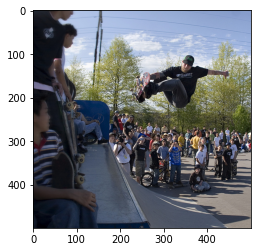

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
print("image",image)
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0
Real Caption: people on cruise ship deck and overlooking the deck
Predicted Caption: man in blue shirt is standing in front of large skyscraper


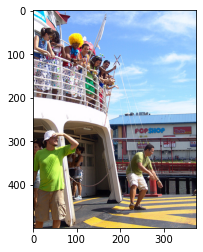

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 21.37267961433182
BLEU-2 score: 5.521941719234084e-153
BLEU-3 score: 1.1810016726277827e-183
BLEU-4 score: 8.875814970513353e-230
Real Caption: small girl dressed in yellow wearing flip flops climbing onto red playground equipment
Predicted Caption: little girl in pink shirt is playing on playground


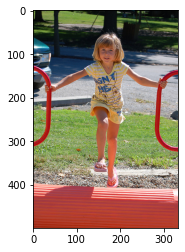

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229
Real Caption: blonde girl climbing on play set
Predicted Caption: little girl in pink shirt is hanging on rope


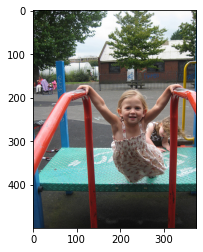

In [ ]:
start_token = tokenizer.word_index['<start>']
end_token = tokenizer.word_index['<end>']
# select random image from validation data
rid = np.random.randint(0, len(img_name_val))
image = img_name_val[rid]
real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
caption,result,attention_weights = evaluate(image)

first = real_caption.split(' ', 1)[1]
real_caption = first.rsplit(' ', 1)[0]

#remove "<unk>" in result
for i in caption:
    if i=="<unk>":
        caption.remove(i)

for i in real_caption:
    if i=="<unk>":
        real_caption.remove(i)

#remove <end> from result         
result_join = ' '.join(caption)
result_final = result_join.rsplit(' ', 1)[0]

real_appn = []
real_appn.append(real_caption.split())
reference = real_appn
candidate = caption
score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
print(f"BLEU-1 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
print(f"BLEU-2 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
print(f"BLEU-3 score: {score*100}")
score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
print(f"BLEU-4 score: {score*100}")

print ('Real Caption:', real_caption)
print ('Predicted Caption:', ' '.join(caption))
temp_image = np.array(Image.open(image))
plt.imshow(temp_image)


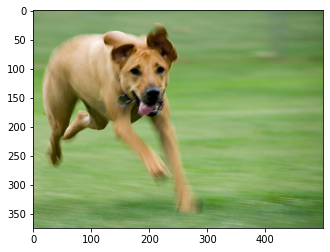

Real Caption: brown dog is running very fast with his tongue out
Predicted Caption: brown dog running through grass
BLEU-1 score: 22.07276647028654
BLEU-2 score: 14.247909490690875
BLEU-3 score: 1.0537466943570253e-91
BLEU-4 score: 3.4150773803399635e-153


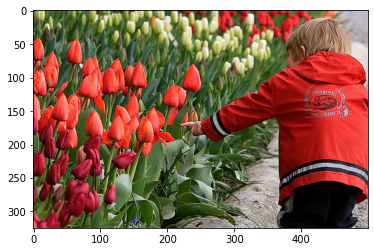

Real Caption: boy in red jacket points at red tulips
Predicted Caption: young boy in red coat is running through the leaves
BLEU-1 score: 30.0
BLEU-2 score: 25.819888974716104
BLEU-3 score: 23.781849487482358
BLEU-4 score: 3.6901226086395757e-76


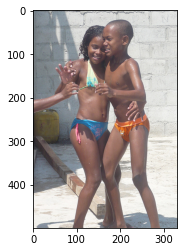

Real Caption: young boy and young girl in bathing suits
Predicted Caption: two boys are playing in the water
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


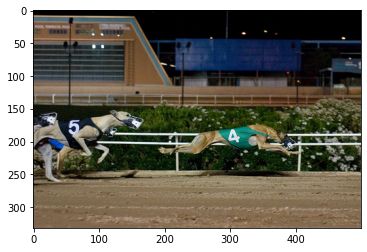

Real Caption: dogs wearing numbered jerseys running at track
Predicted Caption: two greyhounds are racing on the track
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


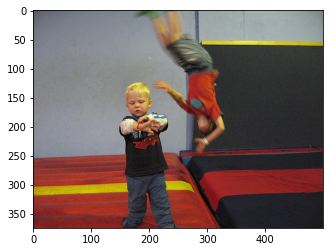

Real Caption: two kids playing on mats
Predicted Caption: boy in red shirt jumps on bed
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


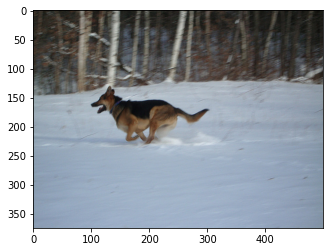

Real Caption: large dog running in snow
Predicted Caption: dog running through snow
BLEU-1 score: 58.41005873035536
BLEU-2 score: 38.94003915357024
BLEU-3 score: 2.600229682193783e-91
BLEU-4 score: 8.214546595247417e-153


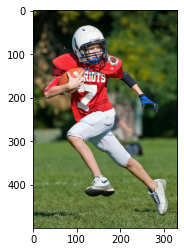

Real Caption: the boy in the red jersey runs with the football
Predicted Caption: man in red uniform and white uniform is running with football
BLEU-1 score: 36.36363636363637
BLEU-2 score: 8.995097368733391e-153
BLEU-3 score: 1.890631331334428e-183
BLEU-4 score: 1.4147351699132999e-229


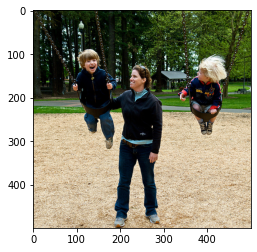

Real Caption: mom is pushing her two kids on the swing
Predicted Caption: two boys are playing with sticks
BLEU-1 score: 10.10884432854389
BLEU-2 score: 3.693595645692774e-153
BLEU-3 score: 9.074319006831119e-184
BLEU-4 score: 7.060301868108111e-230


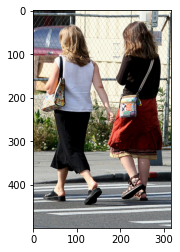

Real Caption: two women with purses walk in an urban location
Predicted Caption: two women in skirts walk down the street
BLEU-1 score: 44.124845129229776
BLEU-2 score: 23.585721816862673
BLEU-3 score: 2.0233830542837192e-91
BLEU-4 score: 6.805395922591311e-153


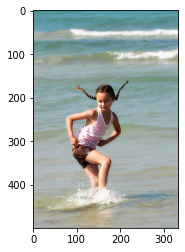

Real Caption: girl in pigtails splashes in the shallow water
Predicted Caption: girl in pink bathing suit is jumping into the water
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153


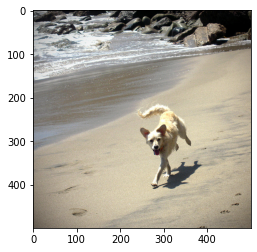

Real Caption: small yellow dog runs on beach
Predicted Caption: dog running on the beach
BLEU-1 score: 49.12384518467891
BLEU-2 score: 9.459952255484061e-153
BLEU-3 score: 1.798842490848482e-183
BLEU-4 score: 1.3127657569660467e-229


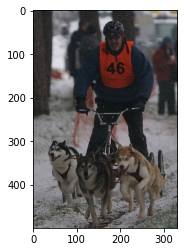

Real Caption: several dogs carry man with helmet through snow
Predicted Caption: two people on sled
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


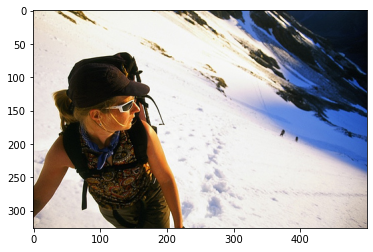

Real Caption: woman climbing snow covered mountain looking at people behind her
Predicted Caption: man in red jacket is skiing down snowy mountain
BLEU-1 score: 9.942659075715216
BLEU-2 score: 4.4493443496507245e-153
BLEU-3 score: 1.1854383244313044e-183
BLEU-4 score: 9.412234823955333e-230


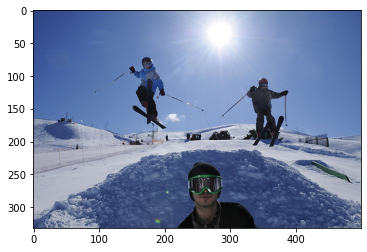

Real Caption: two people are going over <unk> jump while one looks into the camera
Predicted Caption: group of people are standing on top of mountain
BLEU-1 score: 14.248453076221212
BLEU-2 score: 10.686339807165911
BLEU-3 score: 1.1073701419960517e-91
BLEU-4 score: 3.9046024349874316e-153


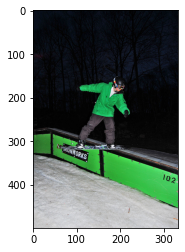

Real Caption: snowboarder in green grinds along the edge of rail at night
Predicted Caption: snowboarder is jumping off of yellow barrel
BLEU-1 score: 16.13480348593598
BLEU-2 score: 4.5026679202702836e-153
BLEU-3 score: 9.9315714226985e-184
BLEU-4 score: 7.521821744402224e-230


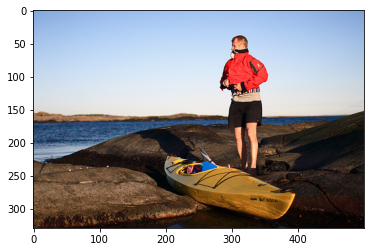

Real Caption: man wearing red jacket standing beside yellow canoe on some rocks with water in the background
Predicted Caption: man in red shirt and blue cap is standing on rock overlooking the ocean
BLEU-1 score: 37.1519099892935
BLEU-2 score: 8.465288316962106e-153
BLEU-3 score: 1.7217557990773525e-183
BLEU-4 score: 1.2778269941762074e-229


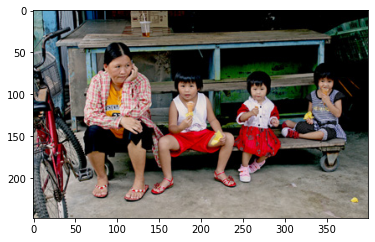

Real Caption: mother sits with three children as they eat ice cream
Predicted Caption: three people are walking down the street
BLEU-1 score: 9.306272250443651
BLEU-2 score: 3.672797542504966e-153
BLEU-3 score: 9.305742700321069e-184
BLEU-4 score: 7.296382734947758e-230


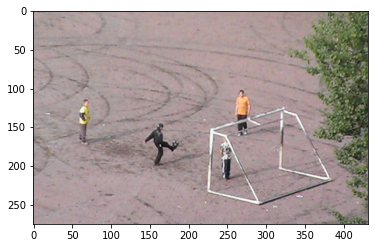

Real Caption: four soccer players play on the pavement
Predicted Caption: group of people walking down dirt path
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


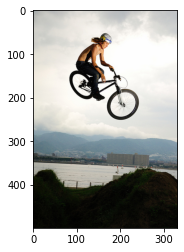

Real Caption: man on bike does very high jump
Predicted Caption: man in blue shirt is doing tricks on bike
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


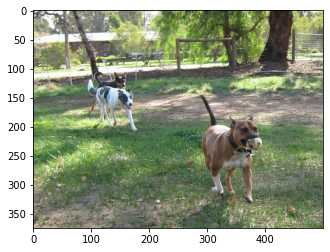

Real Caption: two large dogs chase after another dog that has ball in his mouth and runs from them
Predicted Caption: two dogs running through the grass
BLEU-1 score: 5.32932486932313
BLEU-2 score: 1.3769083644305193e-153
BLEU-3 score: 2.9448537563941883e-184
BLEU-4 score: 2.213204067596096e-230


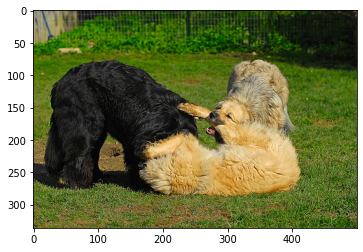

Real Caption: three dogs playing on grass
Predicted Caption: two dogs play in the grass
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


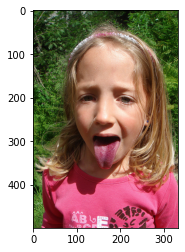

Real Caption: broken image
Predicted Caption: girl in pink shirt and pink shirt is blowing bubbles
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


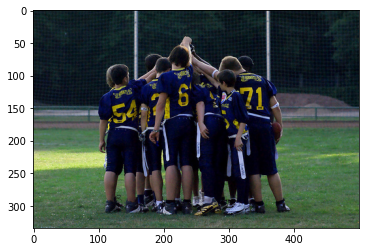

Real Caption: boys huddle during soccer game
Predicted Caption: group of men are running in field
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


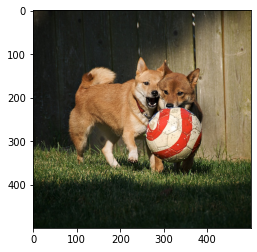

Real Caption: two dogs are playing with red and white ball
Predicted Caption: two dogs playing with red ball
BLEU-1 score: 60.653065971263345
BLEU-2 score: 46.98166288062454
BLEU-3 score: 34.33050063985051
BLEU-4 score: 4.6101141783881114e-76


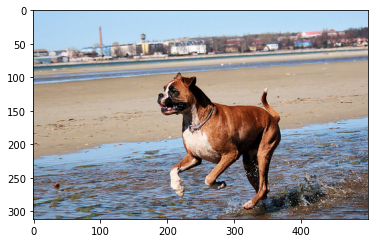

Real Caption: dog running in the surf
Predicted Caption: dog running through water
BLEU-1 score: 38.94003915357025
BLEU-2 score: 31.79440883008189
BLEU-3 score: 2.3024188586848853e-91
BLEU-4 score: 7.422680762211792e-153


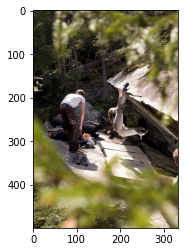

Real Caption: two children playing on rocks
Predicted Caption: young boy is jumping over pile of leaves
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


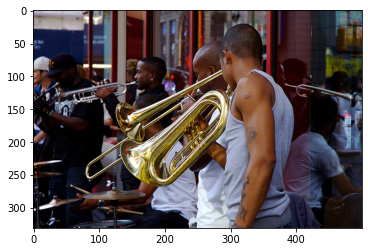

Real Caption: men play <unk> outside building
Predicted Caption: group of people in red and white uniforms are standing in front of large red and white bus
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


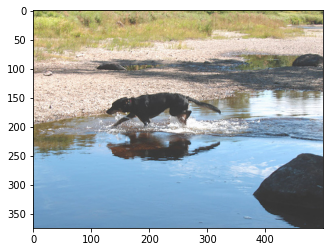

Real Caption: black dog runs through the water
Predicted Caption: black dog is jumping into the water
BLEU-1 score: 57.14285714285714
BLEU-2 score: 43.643578047198474
BLEU-3 score: 3.0771986866000247e-91
BLEU-4 score: 9.85444998995587e-153


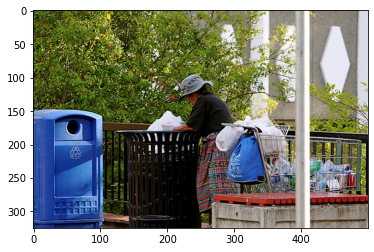

Real Caption: lady digs through garbage can looking to <unk> to the shopping cart beside her
Predicted Caption: man and woman are sitting on bench
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


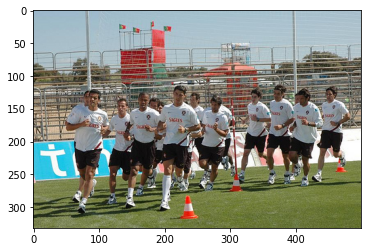

Real Caption: team of men jog around orange cones
Predicted Caption: group of people in red and white uniforms are running down the grass
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


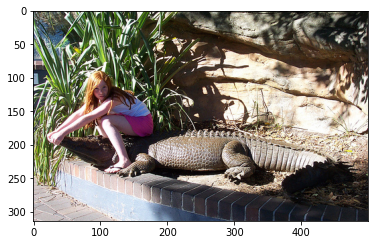

Real Caption: girl is posed over statue of dangerous animal
Predicted Caption: girl sits on crocodile
BLEU-1 score: 9.196986029286059
BLEU-2 score: 2.743770220260171e-153
BLEU-3 score: 6.215759172786402e-184
BLEU-4 score: 4.739132419722992e-230


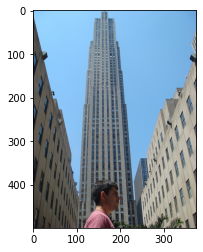

Real Caption: there is skyscraper in the distance with man walking in front of the camera
Predicted Caption: man stands on the edge of balcony
BLEU-1 score: 15.766261764490386
BLEU-2 score: 3.592438492545047e-153
BLEU-3 score: 7.30666408015247e-184
BLEU-4 score: 5.422750778013804e-230


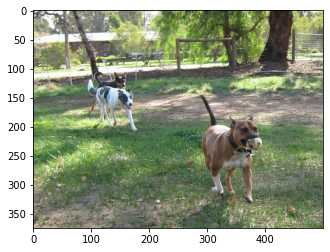

Real Caption: <unk> dog carries some fruit in his mouth while two other dogs follow him
Predicted Caption: two dogs running through the grass
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230


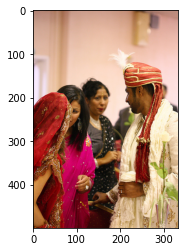

Real Caption: several people dressed in indian clothing are talking to each other
Predicted Caption: group of people in colorful skirts dance
BLEU-1 score: 16.13480348593598
BLEU-2 score: 4.5026679202702836e-153
BLEU-3 score: 9.9315714226985e-184
BLEU-4 score: 7.521821744402224e-230


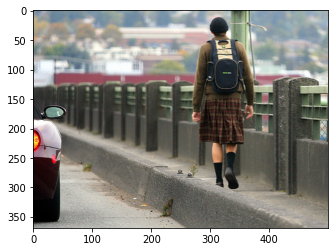

Real Caption: woman wearing brown skirt is walking over bridge
Predicted Caption: woman in red jacket and blue jeans walks down the street
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


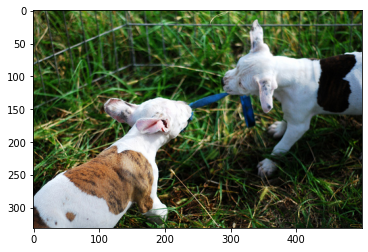

Real Caption: two puppies pulling on string
Predicted Caption: two dogs play in the grass
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


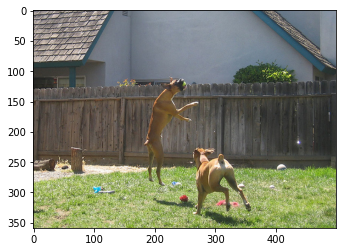

Real Caption: two dogs play catch with rubber ball
Predicted Caption: two dogs play in the grass
BLEU-1 score: 42.324086244530704
BLEU-2 score: 37.855813571333776
BLEU-3 score: 34.45946953219957
BLEU-4 score: 4.888731610154635e-76


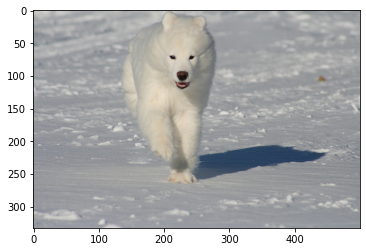

Real Caption: wolf moves over the snow
Predicted Caption: white dog running through snow
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


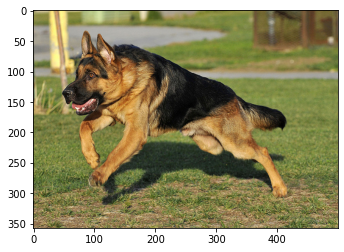

Real Caption: black and tan dog leaps over the green grass
Predicted Caption: dog runs across the grass
BLEU-1 score: 26.959737847033296
BLEU-2 score: 5.191731874703583e-153
BLEU-3 score: 9.87225690478009e-184
BLEU-4 score: 7.204611228887491e-230


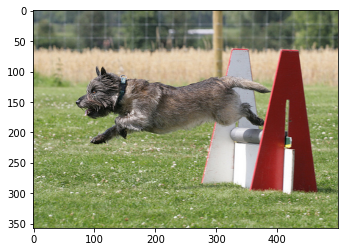

Real Caption: small dog jumping over an obstacle
Predicted Caption: dog jumps over hurdle
BLEU-1 score: 30.326532985631673
BLEU-2 score: 6.397495320955232e-153
BLEU-3 score: 1.261683487508958e-183
BLEU-4 score: 9.291879812217675e-230


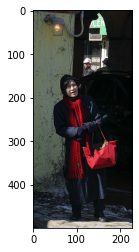

Real Caption: woman is walking with red bag
Predicted Caption: man in red jacket and red jacket is holding sign that says free hugs
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


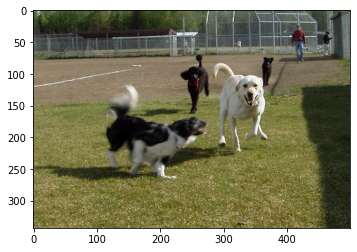

Real Caption: the dogs are running on the grass near baseball field
Predicted Caption: two dogs play in the grass
BLEU-1 score: 25.6708559516296
BLEU-2 score: 16.23567485864776
BLEU-3 score: 1.3021879578069072e-91
BLEU-4 score: 4.3066795795519947e-153


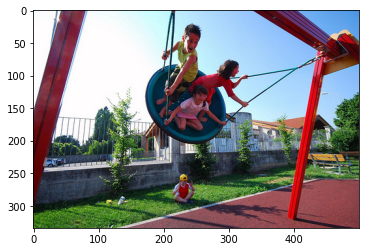

Real Caption: three children riding on large swing
Predicted Caption: two children swing on playground
BLEU-1 score: 49.12384518467891
BLEU-2 score: 9.459952255484061e-153
BLEU-3 score: 1.798842490848482e-183
BLEU-4 score: 1.3127657569660467e-229


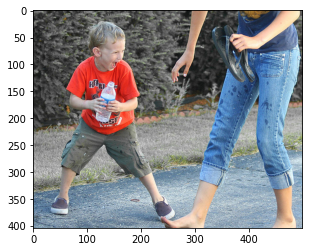

Real Caption: boy wearing red shirt is splashing water on woman legs
Predicted Caption: two boys are playing with bubbles
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


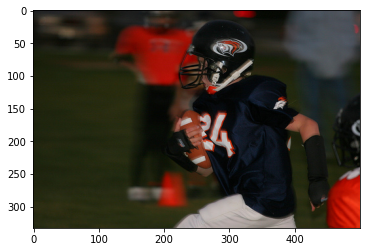

Real Caption: football player is running with the ball
Predicted Caption: man in red shirt and white shirt is holding football
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


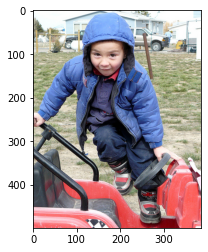

Real Caption: small child wearing blue coat climbing into red toy car
Predicted Caption: two children in red shirts and red shoes are smiling at the camera
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


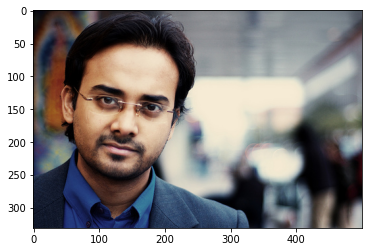

Real Caption: guy wearing glasses
Predicted Caption: man with glasses and glasses is smiling
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


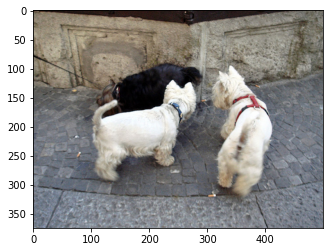

Real Caption: two white dogs look at one black dog on paved walkway
Predicted Caption: two dogs play in the grass
BLEU-1 score: 14.486606950235942
BLEU-2 score: 3.742824986484746e-153
BLEU-3 score: 8.004942453475685e-184
BLEU-4 score: 6.016112399618114e-230


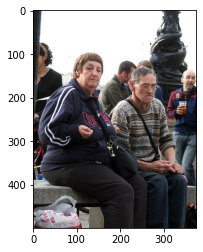

Real Caption: an older couple is resting on bench
Predicted Caption: man and woman sitting on bench
BLEU-1 score: 28.2160574963538
BLEU-2 score: 21.856064155801842
BLEU-3 score: 1.9010499936561078e-91
BLEU-4 score: 6.416038883891965e-153


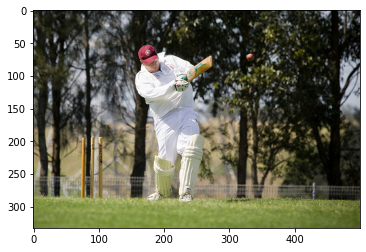

Real Caption: man in rugby uniform hitting ball in grassy field
Predicted Caption: man in blue shirt is jumping in the air
BLEU-1 score: 33.33333333333333
BLEU-2 score: 20.412414523193153
BLEU-3 score: 1.9504730631920925e-91
BLEU-4 score: 6.7393716283177e-153


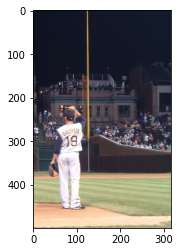

Real Caption: male ballplayer wearing white and blue uniform playing in front of large crowd
Predicted Caption: baseball player in red and white uniform is about to hit ball
BLEU-1 score: 30.668147154310777
BLEU-2 score: 7.923560558566541e-153
BLEU-3 score: 1.6946463306991526e-183
BLEU-4 score: 1.2736110049935266e-229


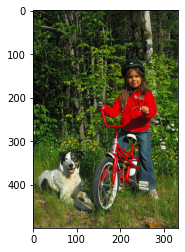

Real Caption: the dog is laying on the ground next to the little girl with the red bike
Predicted Caption: two children playing in the leaves
BLEU-1 score: 3.1479267139593645
BLEU-2 score: 1.15019759190565e-153
BLEU-3 score: 2.825772193556721e-184
BLEU-4 score: 2.1986007635391226e-230


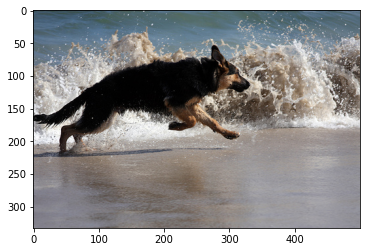

Real Caption: dog running in the surf
Predicted Caption: dog running through the water
BLEU-1 score: 60.0
BLEU-2 score: 38.72983346207417
BLEU-3 score: 2.864380491069489e-91
BLEU-4 score: 9.283142785759642e-153


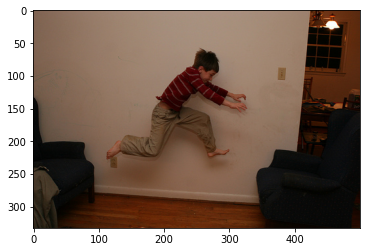

Real Caption: little boy jumping from one chair to another
Predicted Caption: boy in red shirt jumps on bed
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


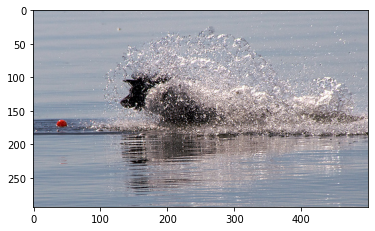

Real Caption: black dog splashing into the water to retrieve red ball
Predicted Caption: dog swimming in the water
BLEU-1 score: 22.07276647028654
BLEU-2 score: 14.247909490690875
BLEU-3 score: 1.0537466943570253e-91
BLEU-4 score: 3.4150773803399635e-153


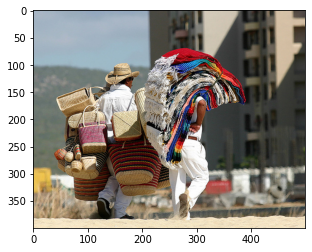

Real Caption: group of people are walking while holding numerous baskets and rugs
Predicted Caption: two women are standing on the pavement
BLEU-1 score: 8.06740174296799
BLEU-2 score: 3.183867019854334e-153
BLEU-3 score: 8.066942687669913e-184
BLEU-4 score: 6.325072941044999e-230


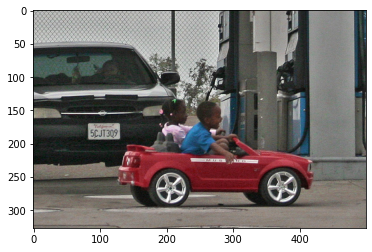

Real Caption: two children are riding in red play vehicle at real gas station
Predicted Caption: two people in red shirts and blue jeans walk down the street
BLEU-1 score: 25.0
BLEU-2 score: 15.075567228888179
BLEU-3 score: 1.6261759223357467e-91
BLEU-4 score: 5.791739854583281e-153


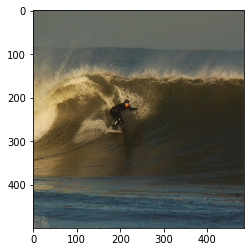

Real Caption: surfer surfs across the large wave
Predicted Caption: man surfing in the ocean
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230


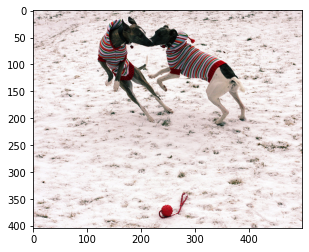

Real Caption: two dogs in striped sweaters fight in the snow
Predicted Caption: two dogs play in the snow
BLEU-1 score: 50.54422164271946
BLEU-2 score: 42.88819424803535
BLEU-3 score: 32.503173264731565
BLEU-4 score: 4.404700362980128e-76


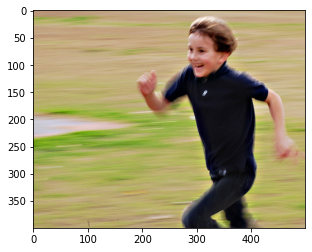

Real Caption: young boy in dark clothing with smile sprints
Predicted Caption: boy in blue shirt is running
BLEU-1 score: 23.88437701912631
BLEU-2 score: 18.500758885923073
BLEU-3 score: 1.609204077733313e-91
BLEU-4 score: 5.431059661402121e-153


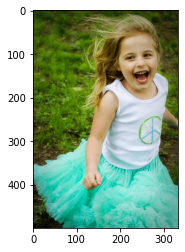

Real Caption: young girl wearing blue smiles
Predicted Caption: young girl in pink dress is blowing bubbles
BLEU-1 score: 25.0
BLEU-2 score: 18.898223650461357
BLEU-3 score: 1.8623269155678368e-91
BLEU-4 score: 6.484592771860511e-153


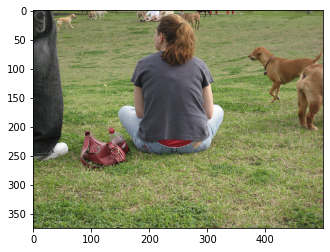

Real Caption: woman sitting in the grass with many dogs around her
Predicted Caption: two dogs are playing with each other
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230


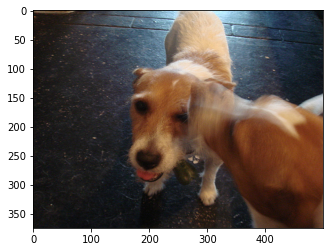

Real Caption: two small brown and white dogs stand together
Predicted Caption: two dogs are playing in the dirt
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


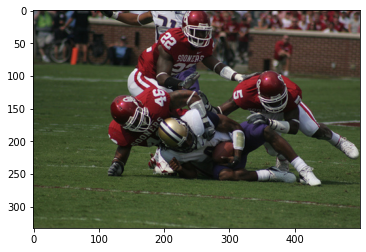

Real Caption: football player is tackled
Predicted Caption: football player in red uniform is tackling another player in white
BLEU-1 score: 27.27272727272727
BLEU-2 score: 16.514456476895408
BLEU-3 score: 1.7175994813661398e-91
BLEU-4 score: 6.061838450024688e-153


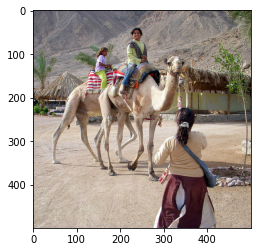

Real Caption: two young girls are riding beige camels as another lady wearing purse watches
Predicted Caption: woman and child are playing with camel
BLEU-1 score: 6.062469223956427
BLEU-2 score: 2.392603769591812e-153
BLEU-3 score: 6.062124254323657e-184
BLEU-4 score: 4.753148692240233e-230


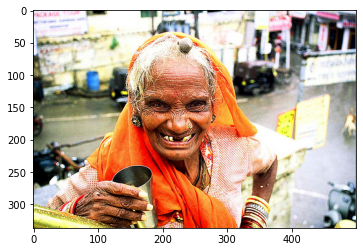

Real Caption: an elderly indian lady is wearing an orange headscarf and <unk>
Predicted Caption: man with mohawk and woman with colorful eyes on her face
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


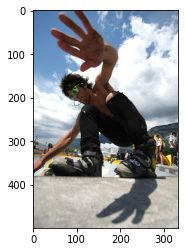

Real Caption: man wearing green glasses crouches near the camera
Predicted Caption: man in blue pants is skateboarding down the railing
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


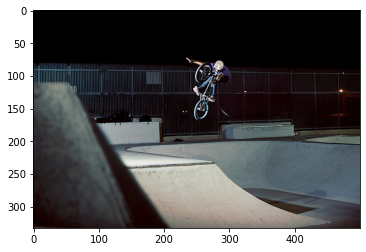

Real Caption: bicyclist rides on ramps
Predicted Caption: man in blue shirt is doing tricks on bike
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


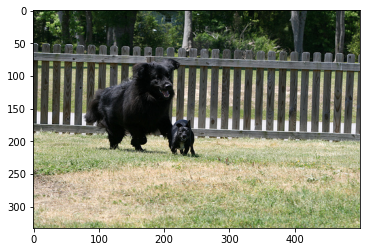

Real Caption: large black dog chases small black dog
Predicted Caption: two dogs running through grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


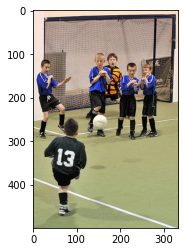

Real Caption: soccer player takes shot on goal with four defenders and goalie
Predicted Caption: group of people playing soccer
BLEU-1 score: 6.02388423824404
BLEU-2 score: 2.009249344215622e-153
BLEU-3 score: 4.759510390450173e-184
BLEU-4 score: 3.669546912321932e-230


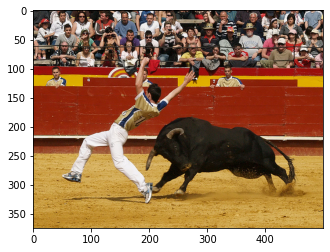

Real Caption: man in bull ring is being <unk> down by the bull
Predicted Caption: man in black shirt is riding bull in the air
BLEU-1 score: 45.241870901797974
BLEU-2 score: 21.327222472151792
BLEU-3 score: 1.923942683267341e-91
BLEU-4 score: 6.552765724042392e-153


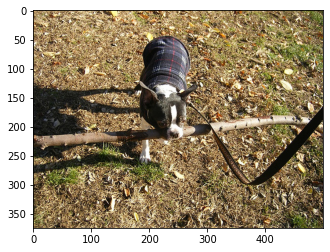

Real Caption: small black and white dog on leash wearing shirt carrying large stick
Predicted Caption: black and white dog is carrying large stick in its mouth
BLEU-1 score: 58.10640921796215
BLEU-2 score: 51.50582679537894
BLEU-3 score: 46.57843739444269
BLEU-4 score: 30.983802298041674


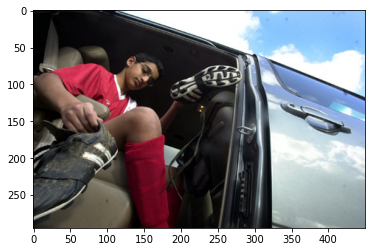

Real Caption: young boy gets out of the van and prepares his shoes for wear during soccer game
Predicted Caption: two people in red and red and red and red and red and red and white and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red shirts are sitting in red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and red and
BLEU-1 score: 1.0000000000000004
BLEU-2 score: 1.491668146240076e-153
BLEU-3 score: 6.432897904653522e-184
BLEU-4 score: 5.761138600803475e-230


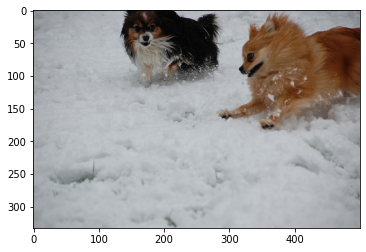

Real Caption: two small dogs playing in the snow together
Predicted Caption: two dogs play in the snow
BLEU-1 score: 59.71094254781577
BLEU-2 score: 41.36895450425727
BLEU-3 score: 34.000147325793876
BLEU-4 score: 4.701927940386645e-76


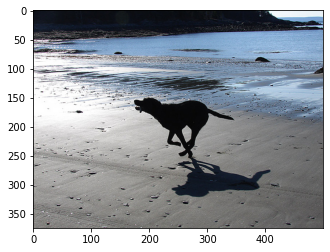

Real Caption: dog running on beach
Predicted Caption: dog running on the beach
BLEU-1 score: 80.0
BLEU-2 score: 63.245553203367585
BLEU-3 score: 54.63634277011612
BLEU-4 score: 7.380245217279165e-76


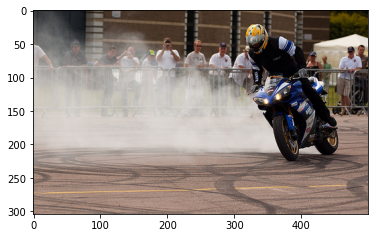

Real Caption: motorcyclist <unk> rubber in circle while crowd watches
Predicted Caption: man in blue and black helmet rides motorcycle
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


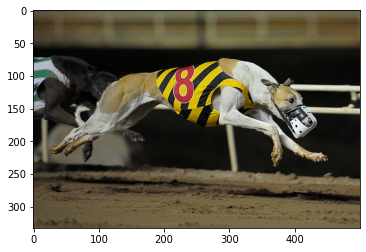

Real Caption: the racing dog has muzzle and is wearing striped jersey
Predicted Caption: greyhound wearing number number number number number number number number number number number number number six is racing
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


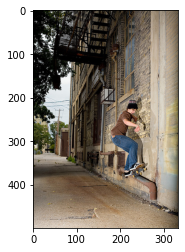

Real Caption: child on skateboard flies through the air alongside building
Predicted Caption: man in blue shirt is skateboarding down the sidewalk
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


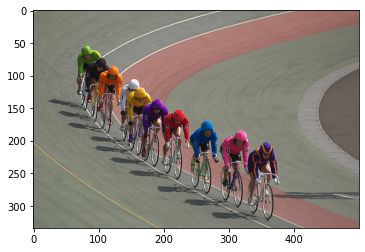

Real Caption: bicyclists stay in line as each wear different color suits
Predicted Caption: group of bicyclists racing around track
BLEU-1 score: 8.556951983876534
BLEU-2 score: 3.126561213214481e-153
BLEU-3 score: 7.68124520511009e-184
BLEU-4 score: 5.9764165035645785e-230


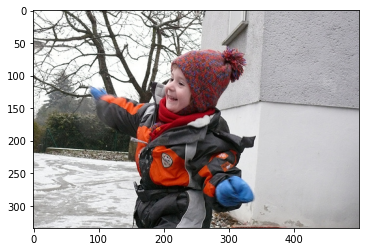

Real Caption: smiling boy in winter clothes waves his <unk> hands outside building in the snow
Predicted Caption: boy in red jacket is laying in the snow
BLEU-1 score: 31.875190040968487
BLEU-2 score: 26.18814091530369
BLEU-3 score: 19.99049299605036
BLEU-4 score: 2.9105601328377187e-76


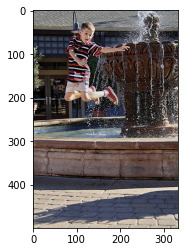

Real Caption: little boy is playfully jumping off the side of fountain
Predicted Caption: boy in red shorts is jumping over bridge
BLEU-1 score: 29.20502936517768
BLEU-2 score: 7.114006032055006e-153
BLEU-3 score: 1.4860807846344539e-183
BLEU-4 score: 1.1103055738259992e-229


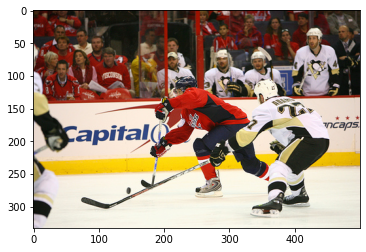

Real Caption: two opposing hockey players make play for the puck with opposing fans and team members watching
Predicted Caption: hockey player in red uniform is jumping over the ice
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


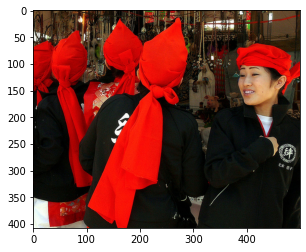

Real Caption: small group of asian women wearing red head scarves and black shirts are shopping
Predicted Caption: group of people in colorful colors stand in the middle of the street
BLEU-1 score: 14.245555056035633
BLEU-2 score: 10.484444638584524
BLEU-3 score: 1.26814139980178e-91
BLEU-4 score: 4.647734350221947e-153


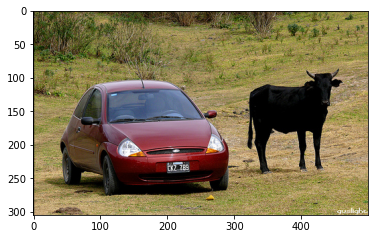

Real Caption: large black animal is as large as small red car
Predicted Caption: large brown dog is pulling large red fire
BLEU-1 score: 38.94003915357025
BLEU-2 score: 8.214546595247417e-153
BLEU-3 score: 1.620033665776733e-183
BLEU-4 score: 1.1931009847695213e-229


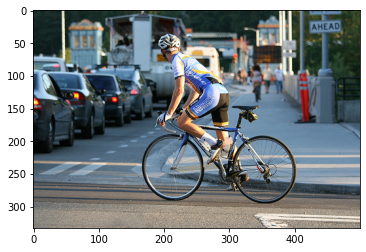

Real Caption: biker in spandex riding on busy street
Predicted Caption: man in red and black helmet rides bike
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


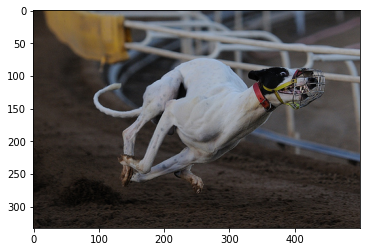

Real Caption: white dog with <unk> and red collar running
Predicted Caption: the greyhound is wearing yellow and yellow jersey is racing jersey is racing
BLEU-1 score: 7.6923076923076925
BLEU-2 score: 4.1371430671115044e-153
BLEU-3 score: 1.1863795531178766e-183
BLEU-4 score: 9.594503055152631e-230


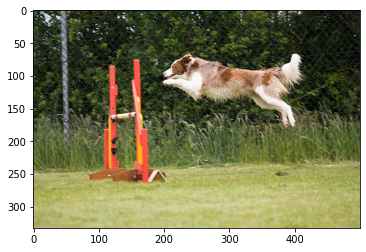

Real Caption: dog is jumping over gate
Predicted Caption: brown dog jumps over hurdle
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229


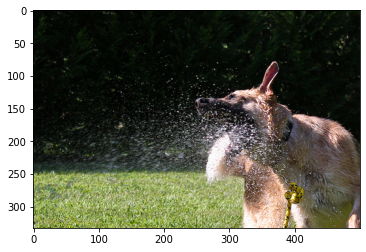

Real Caption: dog tries to drink water from sprinkler
Predicted Caption: dog running through water
BLEU-1 score: 23.618327637050733
BLEU-2 score: 4.982374365655583e-153
BLEU-3 score: 9.826000880602376e-184
BLEU-4 score: 7.236523273960502e-230


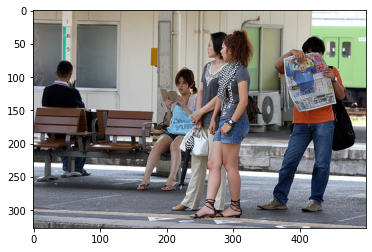

Real Caption: few people <unk> around at train stop
Predicted Caption: group of people stand on the sidewalk
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


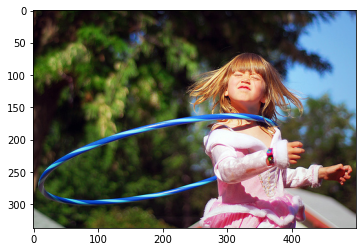

Real Caption: girl wearing pink dress swings hula hoop around her neck
Predicted Caption: girl in pink shirt is blowing bubbles
BLEU-1 score: 18.612544500887303
BLEU-2 score: 5.194120096460954e-153
BLEU-3 score: 1.145671313752559e-183
BLEU-4 score: 8.676910262183262e-230


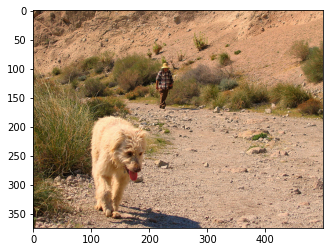

Real Caption: dog in desert area with distant man in background
Predicted Caption: dog running along dirt path
BLEU-1 score: 8.986579282344431
BLEU-2 score: 2.997447795420392e-153
BLEU-3 score: 7.100355149153815e-184
BLEU-4 score: 5.474320712955125e-230


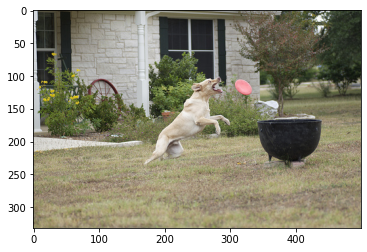

Real Caption: yellow dog chases red frisbee next to black pot
Predicted Caption: two dogs play in the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


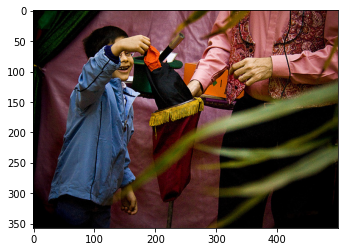

Real Caption: smiling boy pulling something from <unk> bag
Predicted Caption: two people are standing on the edge of the road
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


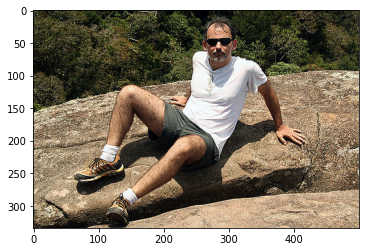

Real Caption: man in shorts in sitting up on rock posing for the camera
Predicted Caption: man in red shirt and glasses is rock climbing
BLEU-1 score: 23.88437701912631
BLEU-2 score: 14.62613413027904
BLEU-3 score: 1.3975750202079033e-91
BLEU-4 score: 4.828970785282295e-153


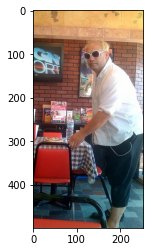

Real Caption: the large man grabs seat at restaurant
Predicted Caption: man in black shirt is sitting on the floor with his feet up
BLEU-1 score: 15.384615384615385
BLEU-2 score: 5.850803834986753e-153
BLEU-3 score: 1.4606045589277217e-183
BLEU-4 score: 1.1409851298103346e-229


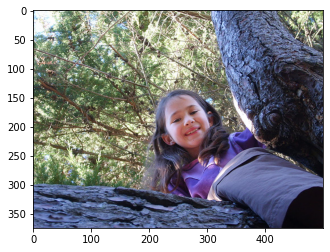

Real Caption: girl in tree smiles
Predicted Caption: girl in red shirt and black shirt is smiling
BLEU-1 score: 22.22222222222222
BLEU-2 score: 16.666666666666668
BLEU-3 score: 1.7270804940051994e-91
BLEU-4 score: 6.08970970641905e-153


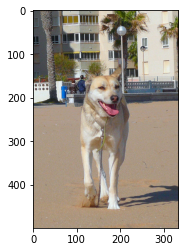

Real Caption: sandy colored dog walking toward the camera with its leash attached and dragging below
Predicted Caption: dog running on the beach
BLEU-1 score: 6.611955528863462
BLEU-2 score: 1.559452474871608e-153
BLEU-3 score: 3.2158411549258115e-184
BLEU-4 score: 2.3949323699607067e-230


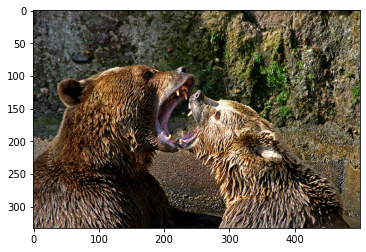

Real Caption: the bears are facing each other with their mouths wide open
Predicted Caption: two dogs are playing with each other
BLEU-1 score: 32.26960697187196
BLEU-2 score: 17.42757960201972
BLEU-3 score: 1.411491490766853e-91
BLEU-4 score: 4.679577191845681e-153


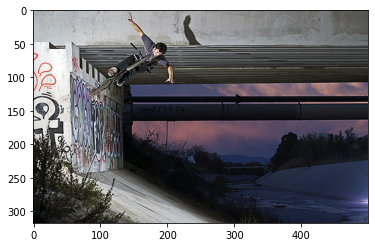

Real Caption: bicycler does tricks under an overpass
Predicted Caption: man in green shirt is doing tricks on bike
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


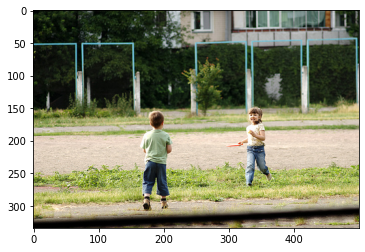

Real Caption: young boy and girl playing
Predicted Caption: two children running through the grass
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


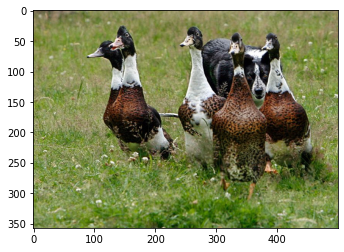

Real Caption: group of ducks in field
Predicted Caption: two dogs running through field
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


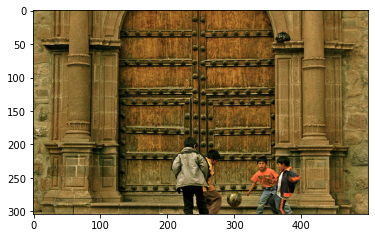

Real Caption: four boys playing game with soccer ball in front of large set of ornate doors
Predicted Caption: group of people stand in the middle of brick building
BLEU-1 score: 18.195919791379005
BLEU-2 score: 4.955478567099638e-153
BLEU-3 score: 1.0824199654502182e-183
BLEU-4 score: 8.177892479606618e-230


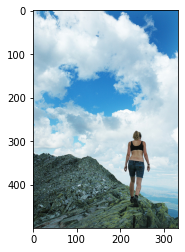

Real Caption: woman in black sports bra and shorts standing on an rocky elevation
Predicted Caption: man in red shirt is standing on top of mountain
BLEU-1 score: 24.561922592339457
BLEU-2 score: 14.947910066133426
BLEU-3 score: 1.4935097310718617e-91
BLEU-4 score: 5.218347612900714e-153


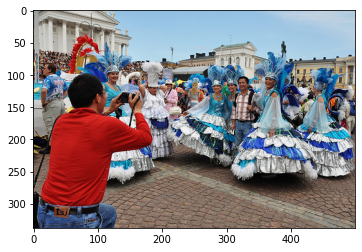

Real Caption: man photographs costumed dancers
Predicted Caption: people are gathered around large market
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


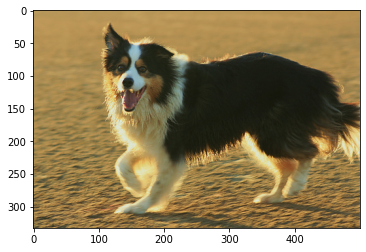

Real Caption: dog has mouth open in field
Predicted Caption: black and white dog running on the grass
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


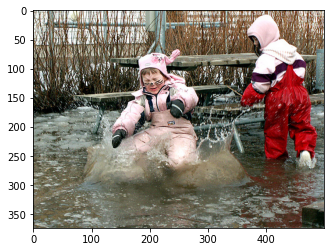

Real Caption: two children play in the melting <unk>
Predicted Caption: two children play in water
BLEU-1 score: 53.62560368285115
BLEU-2 score: 51.9227674985004
BLEU-3 score: 50.9213846729761
BLEU-4 score: 44.827003201768264


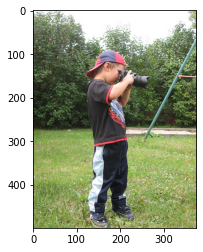

Real Caption: young boy is looking through binoculars at playground
Predicted Caption: boy in red shirt is hanging from swing
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


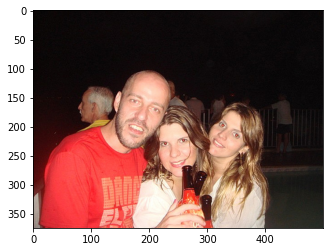

Real Caption: man in red posing with two young women and three beer bottles
Predicted Caption: two women are posing for picture
BLEU-1 score: 18.393972058572118
BLEU-2 score: 3.8802770575274625e-153
BLEU-3 score: 7.652497180273445e-184
BLEU-4 score: 5.6358099924748865e-230


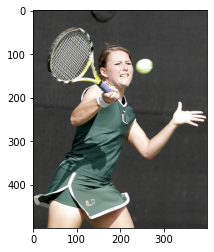

Real Caption: tennis player hits the ball
Predicted Caption: man in red shirt and white shorts plays tennis
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


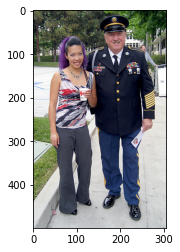

Real Caption: man in uniform stands near woman with purple hair
Predicted Caption: two women in skirts walk down the street
BLEU-1 score: 11.031211282307446
BLEU-2 score: 4.6541503835249794e-153
BLEU-3 score: 1.2111358303072744e-183
BLEU-4 score: 9.55980462367717e-230


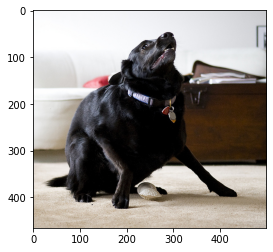

Real Caption: black dog inside house is looking at something at higher position
Predicted Caption: black dog jumps in the air to catch ball
BLEU-1 score: 17.794164509262398
BLEU-2 score: 13.3456233819468
BLEU-3 score: 1.382937949398001e-91
BLEU-4 score: 4.876258334835267e-153


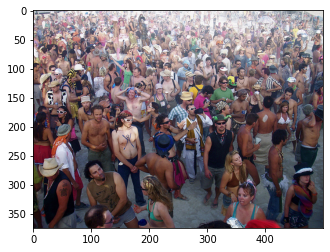

Real Caption: crowd of people are socializing
Predicted Caption: crowd of people in white and red white and red and red white and red and white and red and white and white and white and white and white and white and white and white and white and white and white and white and red and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and white and
BLEU-1 score: 2.9999999999999996
BLEU-2 score: 2.461829819586655
BLEU-3 score: 2.7377071741081376
BLEU-4 score: 6.090579310486176e-77


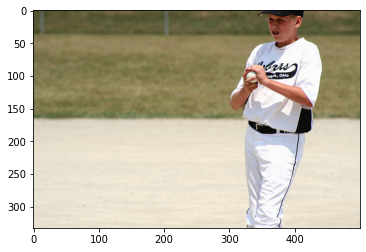

Real Caption: the boy is wearing white baseball uniform and holding baseball
Predicted Caption: man in blue shirt and white shorts is running
BLEU-1 score: 29.827977227145652
BLEU-2 score: 7.70649047396433e-153
BLEU-3 score: 1.6482206083667876e-183
BLEU-4 score: 1.2387197655613556e-229


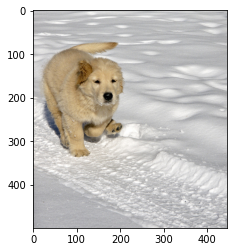

Real Caption: golden retriever puppy walking through snow
Predicted Caption: white dog running through snow
BLEU-1 score: 32.749230123119276
BLEU-2 score: 25.890539701513365
BLEU-3 score: 2.0765597558437652e-91
BLEU-4 score: 6.867731683891005e-153


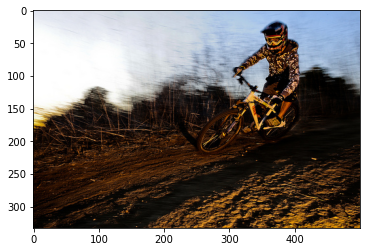

Real Caption: dirt bike rider jumping down the hill
Predicted Caption: man on bike is riding dirt bike
BLEU-1 score: 28.57142857142857
BLEU-2 score: 21.82178902359924
BLEU-3 score: 2.030194004994321e-91
BLEU-4 score: 6.968148412761693e-153


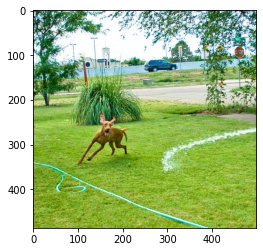

Real Caption: brown dog plays with the hose
Predicted Caption: dog running through grass
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230


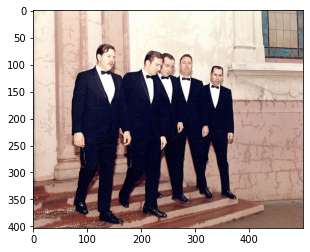

Real Caption: men in suits and ties walking <unk>
Predicted Caption: group of people stand on steps
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


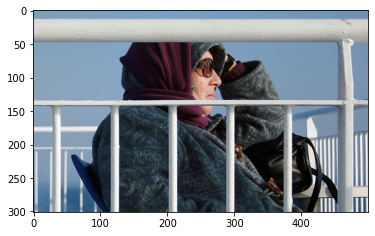

Real Caption: an older lady dressed in winter clothes looks out over white balcony
Predicted Caption: man and woman are sitting on wooden bench
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


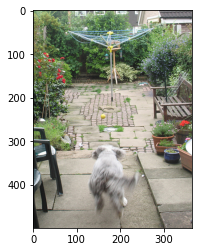

Real Caption: dog runs for tennis ball in backyard with tile courtyard
Predicted Caption: dog is jumping over hurdle
BLEU-1 score: 7.357588823428847
BLEU-2 score: 2.454102690856474e-153
BLEU-3 score: 5.813279118387829e-184
BLEU-4 score: 4.481994719908145e-230


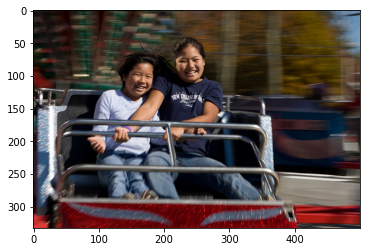

Real Caption: two girls on an amusement park ride
Predicted Caption: two young boys are sitting on wooden bench
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


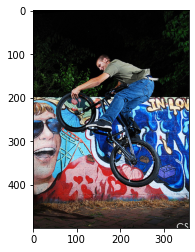

Real Caption: lone bicyclist jumping on his bike in front of graffitied wall
Predicted Caption: man in blue and black is riding bike
BLEU-1 score: 17.182231969774307
BLEU-2 score: 5.126037622123983e-153
BLEU-3 score: 1.1612566946930451e-183
BLEU-4 score: 8.853864984883468e-230


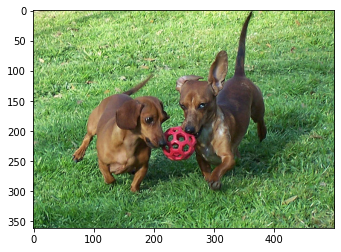

Real Caption: two little wiener dogs are running on the grass carrying red ball between them
Predicted Caption: two dogs running through grass
BLEU-1 score: 13.223911057726925
BLEU-2 score: 2.2053988398396557e-153
BLEU-3 score: 3.9591648720916016e-184
BLEU-4 score: 2.8480706143077243e-230


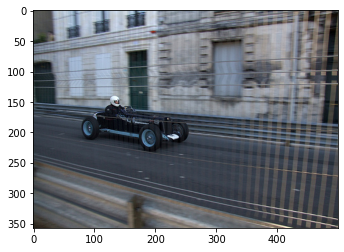

Real Caption: man wearing helmet driving black race car down the street
Predicted Caption: black and white rally car is driving through the dirt
BLEU-1 score: 40.0
BLEU-2 score: 9.434137710479516e-153
BLEU-3 score: 1.9454705288851736e-183
BLEU-4 score: 1.4488496539373276e-229


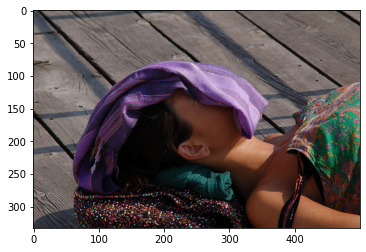

Real Caption: girl lays on wooden deck with piece of clothing covering her face
Predicted Caption: girl in pink shirt is holding camera
BLEU-1 score: 6.993452279385044
BLEU-2 score: 2.7600239552551947e-153
BLEU-3 score: 6.99305433449238e-184
BLEU-4 score: 5.483065946899793e-230


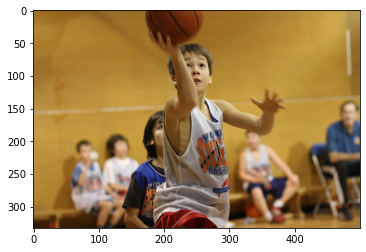

Real Caption: boy throws basketball during game
Predicted Caption: man is holding flag to his right
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


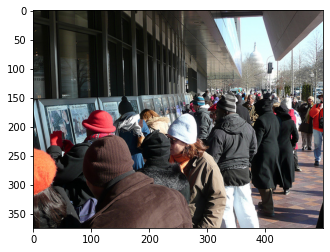

Real Caption: crowd of people in front of memorial in washington <unk>
Predicted Caption: group of people are standing in front of large crowd
BLEU-1 score: 60.0
BLEU-2 score: 44.721359549995796
BLEU-3 score: 33.066025977478425
BLEU-4 score: 4.856474469839072e-76


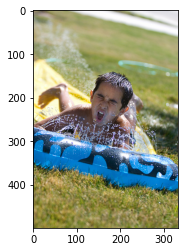

Real Caption: boy is being splashed in the face whilst riding blue ring along yellow water slide
Predicted Caption: boy in blue swim trunks is smiling
BLEU-1 score: 18.223231847084023
BLEU-2 score: 3.595974808349168e-153
BLEU-3 score: 6.9049206719145e-184
BLEU-4 score: 5.051405824216811e-230


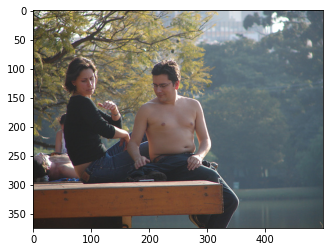

Real Caption: lady and man with no shirt sit on dock
Predicted Caption: man and woman sitting on bench
BLEU-1 score: 30.326532985631673
BLEU-2 score: 6.397495320955232e-153
BLEU-3 score: 1.261683487508958e-183
BLEU-4 score: 9.291879812217675e-230


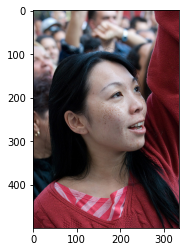

Real Caption: closeup picture of girl with long black hair and one hand raised in the air
Predicted Caption: girl with pink hair and white shirt is smiling
BLEU-1 score: 22.818538623670754
BLEU-2 score: 17.113903967753068
BLEU-3 score: 1.344005116346986e-91
BLEU-4 score: 4.421625271317475e-153


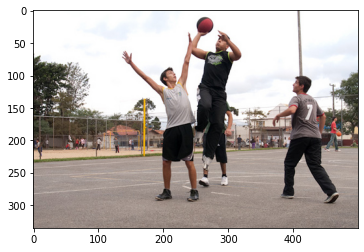

Real Caption: the three men are playing basketball on blacktop
Predicted Caption: group of people are walking down the street
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


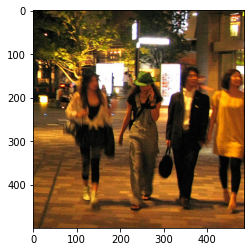

Real Caption: four people walk down sidewalk at night
Predicted Caption: two people walk down the street
BLEU-1 score: 42.324086244530704
BLEU-2 score: 37.855813571333776
BLEU-3 score: 34.45946953219957
BLEU-4 score: 4.888731610154635e-76


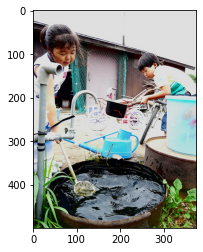

Real Caption: two children outside near container of water and watering pail
Predicted Caption: two boys play in water
BLEU-1 score: 14.715177646857693
BLEU-2 score: 3.470625308865635e-153
BLEU-3 score: 7.156986109817879e-184
BLEU-4 score: 5.330020010319017e-230


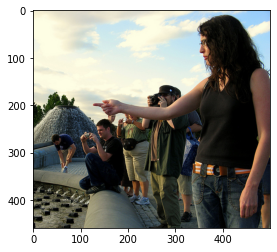

Real Caption: woman points to the left as she and others look that way
Predicted Caption: group of people are sitting on rock
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


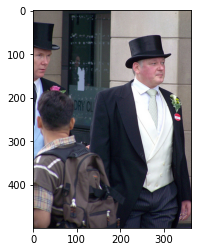

Real Caption: man wearing formal suit and hat stands next to building
Predicted Caption: man and woman are sitting in front of an art gallery
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


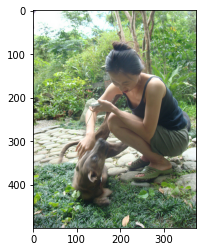

Real Caption: woman plays with brown dog
Predicted Caption: the little boy is playing with the little dog
BLEU-1 score: 22.22222222222222
BLEU-2 score: 7.031791076575252e-153
BLEU-3 score: 1.6309584783156365e-183
BLEU-4 score: 1.2508498911928378e-229


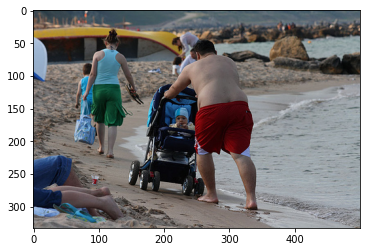

Real Caption: man in <unk> swim trunks pushing baby stroller along edge of beach
Predicted Caption: man and woman on beach
BLEU-1 score: 9.86387855766426
BLEU-2 score: 2.3264297168112673e-153
BLEU-3 score: 4.797471258609553e-184
BLEU-4 score: 3.572819258687922e-230


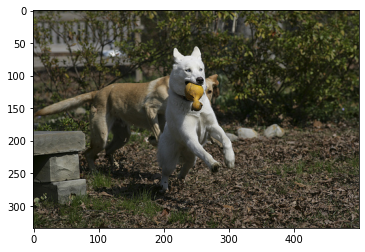

Real Caption: dog running in park with rubber chicken in its mouth
Predicted Caption: dog running through the grass
BLEU-1 score: 14.715177646857693
BLEU-2 score: 11.633369384516797
BLEU-3 score: 9.330584440207895e-92
BLEU-4 score: 3.0858707633577667e-153


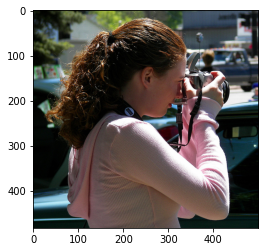

Real Caption: girl wearing pink hoodie looks through her camera
Predicted Caption: woman in blue shirt and man in black shirt
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


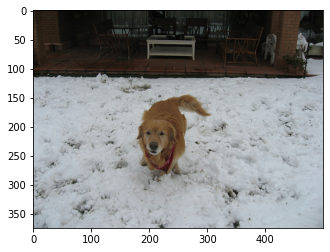

Real Caption: dog looking at the camera in snow
Predicted Caption: brown dog is running through snow
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229


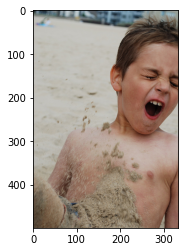

Real Caption: the boy is playing in the sand
Predicted Caption: boy in blue swim trunks is blowing bubbles
BLEU-1 score: 37.5
BLEU-2 score: 9.134564559628536e-153
BLEU-3 score: 1.9081654987219002e-183
BLEU-4 score: 1.4256605770826505e-229


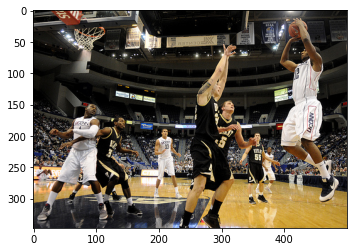

Real Caption: basketball player in white uniform leaping to make shot while being blocked by player in black
Predicted Caption: basketball player in white uniform is jumping in the air
BLEU-1 score: 32.928698165641585
BLEU-2 score: 28.340511023960126
BLEU-3 score: 27.50573856764223
BLEU-4 score: 22.563491294442887


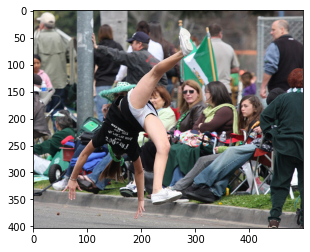

Real Caption: someone in shorts is <unk> in front of crowd
Predicted Caption: group of people are watching chess game
BLEU-1 score: 10.735389901075512
BLEU-2 score: 4.236810678370506e-153
BLEU-3 score: 1.073477903059106e-183
BLEU-4 score: 8.416851712392763e-230


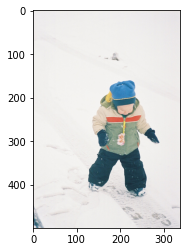

Real Caption: small child in winter gear is making tracks in shallow snow
Predicted Caption: the boy is wearing red jacket and hat
BLEU-1 score: 8.591115984887153
BLEU-2 score: 3.6246559632213337e-153
BLEU-3 score: 9.432335330491414e-184
BLEU-4 score: 7.445183326929417e-230


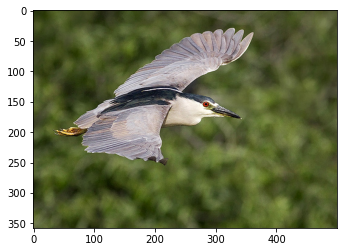

Real Caption: white bird flies <unk> the backdrop of green foliage
Predicted Caption: the bird is flying through the air
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229


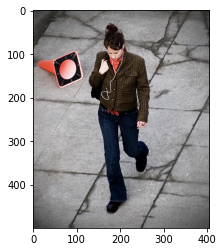

Real Caption: girl wearing brown jacket and blue jeans has on some white headphones and is walking
Predicted Caption: man in red jacket and black coat walks down the sidewalk
BLEU-1 score: 12.638980516343251
BLEU-2 score: 9.37331881837364
BLEU-3 score: 1.0572294601478943e-91
BLEU-4 score: 3.807643477730697e-153


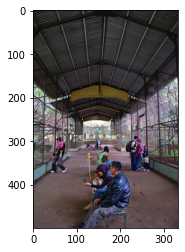

Real Caption: the people under the canopy are sitting on bench the mother is taking picture of child with her cellphone
Predicted Caption: group of people are standing on the street
BLEU-1 score: 15.802474737796654
BLEU-2 score: 2.981654456854901e-153
BLEU-3 score: 5.62361721126051e-184
BLEU-4 score: 4.095655460494635e-230


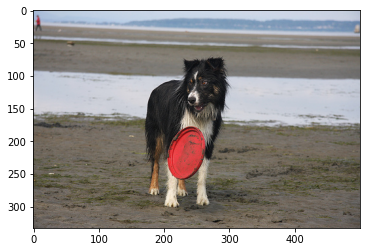

Real Caption: dog catching red frisbee
Predicted Caption: dog running on the beach
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


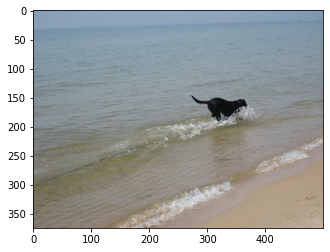

Real Caption: the dog is playing in the water
Predicted Caption: black dog running on the beach
BLEU-1 score: 28.2160574963538
BLEU-2 score: 7.290027635886345e-153
BLEU-3 score: 1.5591498913318324e-183
BLEU-4 score: 1.171778691554733e-229


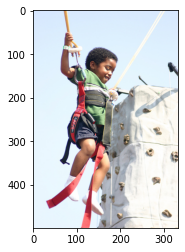

Real Caption: child wearing green shirt is bungee climbing
Predicted Caption: man climbs rock wall
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


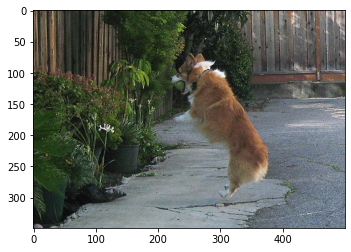

Real Caption: dog catches ball in midair
Predicted Caption: dog jumping over brick fence
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


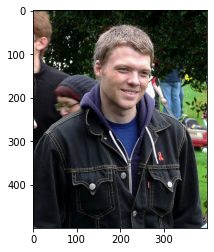

Real Caption: man wearing jeans jacket is smiling
Predicted Caption: man with glasses and glasses is smiling
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153


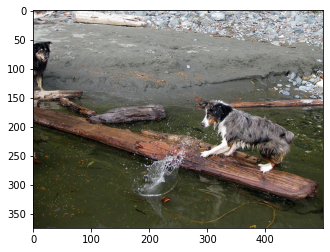

Real Caption: dog on log looks at splash in the water as another dog looks on
Predicted Caption: two dogs swimming in the water
BLEU-1 score: 13.179856905786336
BLEU-2 score: 11.788422390023316
BLEU-3 score: 10.730789906713799
BLEU-4 score: 1.5223667842553552e-76


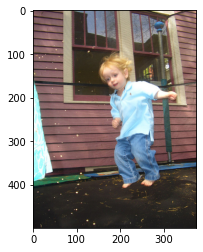

Real Caption: young boy jumping on trampoline outside of house
Predicted Caption: boy in red shirt jumps into the air
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


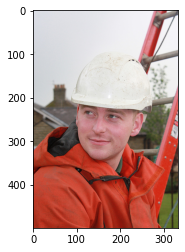

Real Caption: smiling construction worker with white helmet
Predicted Caption: man in red shirt and red cap is holding cup
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


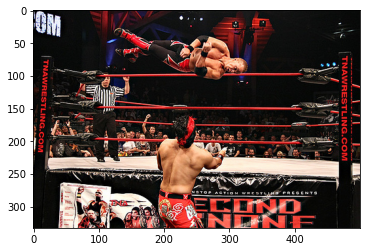

Real Caption: professional wrestler falls outside the ring
Predicted Caption: two men are playing in the band
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


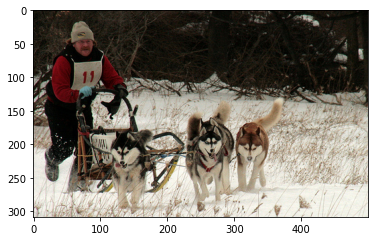

Real Caption: man rides sled pulled by team of dogs
Predicted Caption: three dogs are running through snow
BLEU-1 score: 11.942188509563156
BLEU-2 score: 4.3634676769543673e-153
BLEU-3 score: 1.072004124838459e-183
BLEU-4 score: 8.34076112986429e-230


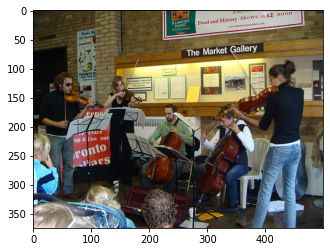

Real Caption: the string <unk> plays for an audience
Predicted Caption: group of people are sitting in the middle of the street
BLEU-1 score: 9.09090909090909
BLEU-2 score: 4.497548684366688e-153
BLEU-3 score: 1.2473514990254889e-183
BLEU-4 score: 1.0003688322288243e-229


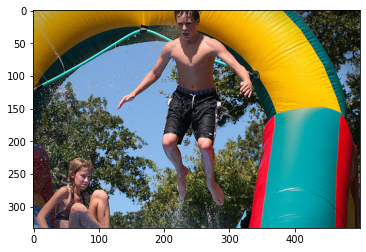

Real Caption: young boy jumping and young girl seating in an inflatable pool
Predicted Caption: girl in blue shirt is swimming in the water
BLEU-1 score: 17.794164509262398
BLEU-2 score: 5.630618124510453e-153
BLEU-3 score: 1.3059694561916118e-183
BLEU-4 score: 1.0016022933125248e-229


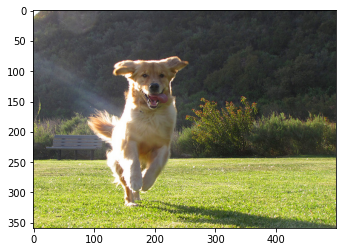

Real Caption: the dog plays in the park
Predicted Caption: dog running through grass
BLEU-1 score: 15.163266492815836
BLEU-2 score: 4.5237123240565193e-153
BLEU-3 score: 1.0248054361722373e-183
BLEU-4 score: 7.813508425061864e-230


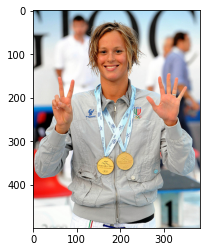

Real Caption: an olympic winner wearing her two gold medals and grey jacket showing peace sign and wave
Predicted Caption: two women one with pink hair and black hair are smiling
BLEU-1 score: 11.54066216255058
BLEU-2 score: 4.0372374044186574e-153
BLEU-3 score: 9.747455682531433e-184
BLEU-4 score: 7.551114723170368e-230


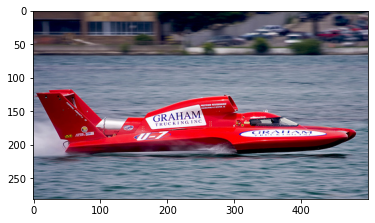

Real Caption: red boat marked <unk> races across water
Predicted Caption: man in red and red helmet is riding red kayak
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


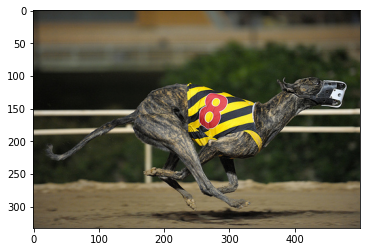

Real Caption: <unk> has the number
Predicted Caption: the dog is running through the sand
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


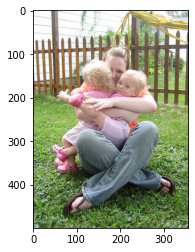

Real Caption: woman is sitting on the grass and holding two children
Predicted Caption: girl in pink shirt is laying on her back
BLEU-1 score: 19.885318151430436
BLEU-2 score: 6.29232312294398e-153
BLEU-3 score: 1.4594457704885681e-183
BLEU-4 score: 1.1193096620723277e-229


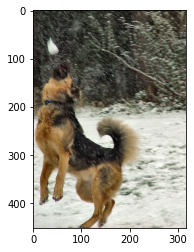

Real Caption: dog tries to catch snowball in its mouth
Predicted Caption: dog runs through the snow
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


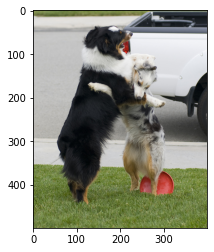

Real Caption: two dogs the white one standing on frisbee playing together on grass
Predicted Caption: two dogs play with red ball
BLEU-1 score: 12.262648039048077
BLEU-2 score: 9.49860632712725
BLEU-3 score: 8.261929215253368e-92
BLEU-4 score: 2.788399004651202e-153


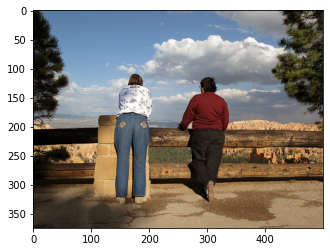

Real Caption: the two women are looking at mountains at fence
Predicted Caption: two people are standing on the shore of lake
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


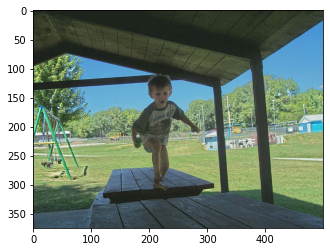

Real Caption: boy jumps from one table to another at park
Predicted Caption: man in black shirt is standing on wooden fence
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


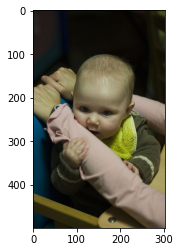

Real Caption: baby is sitting in his high chair between person arms
Predicted Caption: baby is sitting on bed
BLEU-1 score: 22.07276647028654
BLEU-2 score: 20.149586837199372
BLEU-3 score: 18.437647942906203
BLEU-4 score: 2.5266298691547124e-76


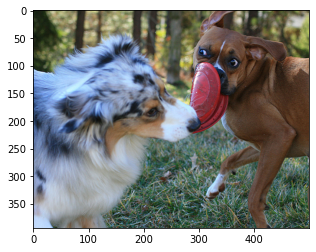

Real Caption: two dogs play with frisbee
Predicted Caption: two dogs are playing with red toy
BLEU-1 score: 42.857142857142854
BLEU-2 score: 26.726124191242434
BLEU-3 score: 2.2927933779232266e-91
BLEU-4 score: 7.711523862191632e-153


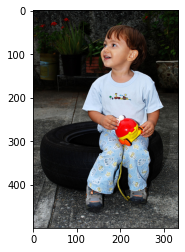

Real Caption: baby sits on tire and holds toy
Predicted Caption: boy in red shirt is playing with his toy
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


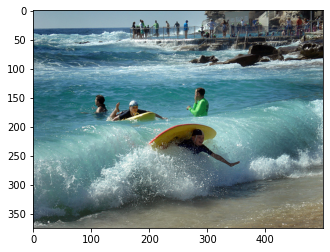

Real Caption: four swimmers in the crystal blue ocean with yellow surfboards
Predicted Caption: two people are playing in the water
BLEU-1 score: 18.612544500887303
BLEU-2 score: 14.215565675175021
BLEU-3 score: 1.3225476692186996e-91
BLEU-4 score: 4.539324034745998e-153


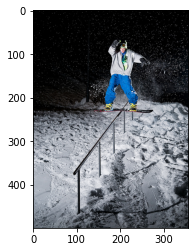

Real Caption: guy on snowboard grinding
Predicted Caption: snowboarder is in the air
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


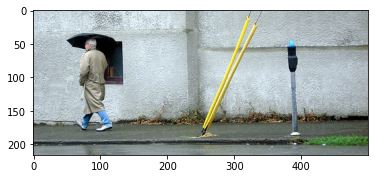

Real Caption: man with white hair long trench coat and an umbrella walks past parking meter
Predicted Caption: man in black shirt is standing on sidewalk
BLEU-1 score: 5.904581909262685
BLEU-2 score: 2.4911871828277866e-153
BLEU-3 score: 6.48274294660805e-184
BLEU-4 score: 5.116994679231889e-230


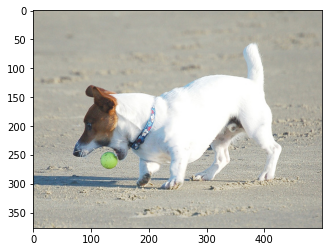

Real Caption: small dog catching ball in its mouth on beach
Predicted Caption: dog runs on the beach
BLEU-1 score: 26.959737847033296
BLEU-2 score: 5.191731874703583e-153
BLEU-3 score: 9.87225690478009e-184
BLEU-4 score: 7.204611228887491e-230


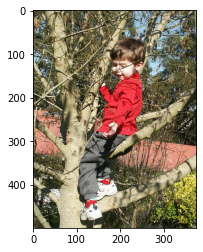

Real Caption: little boy in red is climbing tree
Predicted Caption: child climbs tree
BLEU-1 score: 8.786571270524224
BLEU-2 score: 2.2701381082415207e-153
BLEU-3 score: 4.855243027268271e-184
BLEU-4 score: 3.648956622645728e-230


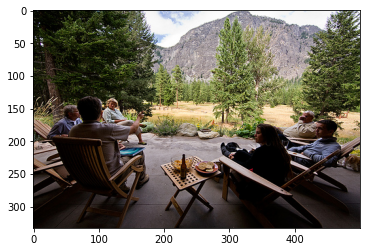

Real Caption: group of adults sit in wood lawn chairs talking surrounded by wilderness
Predicted Caption: group of people sitting on bench
BLEU-1 score: 12.262648039048077
BLEU-2 score: 9.49860632712725
BLEU-3 score: 8.261929215253368e-92
BLEU-4 score: 2.788399004651202e-153


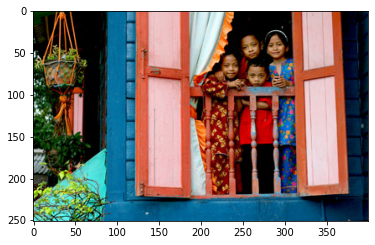

Real Caption: four children looking out window
Predicted Caption: three people stand in the store
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


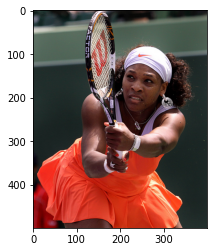

Real Caption: woman playing tennis swinging her racket
Predicted Caption: man in red shirt and white headband is playing tennis
BLEU-1 score: 20.0
BLEU-2 score: 14.9071198499986
BLEU-3 score: 1.6152493512830776e-91
BLEU-4 score: 5.75929185611095e-153


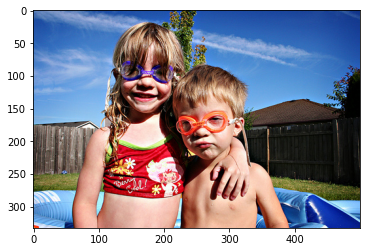

Real Caption: two children in goggles standing beside pool
Predicted Caption: girl in blue shirt is jumping into pool
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


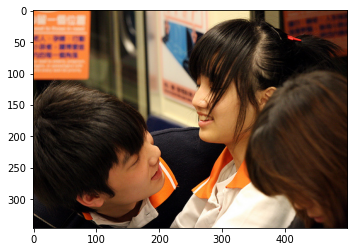

Real Caption: girl and boy look at each other
Predicted Caption: girl is holding two fingers in her hand
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


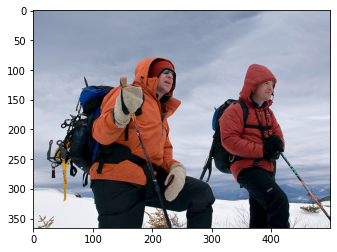

Real Caption: two mountaineers are looking ahead on snowy trail
Predicted Caption: two people are walking on snowy mountain
BLEU-1 score: 49.53587998572467
BLEU-2 score: 26.7524327879111
BLEU-3 score: 2.1667283753546875e-91
BLEU-4 score: 7.183445846156677e-153


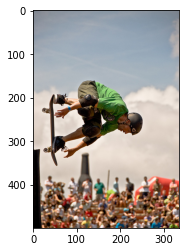

Real Caption: skateboarder wearing green shirt and jumping in the air
Predicted Caption: skateboarder does trick in the air
BLEU-1 score: 40.43537731417556
BLEU-2 score: 31.321108587083025
BLEU-3 score: 26.916921090198713
BLEU-4 score: 3.7641424643403336e-76


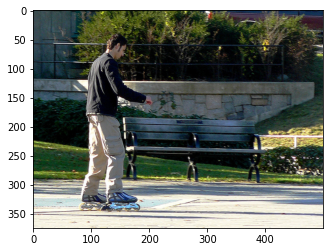

Real Caption: man is inline skating in front of wooden bench
Predicted Caption: man in black shirt and black shorts is walking down the sidewalk
BLEU-1 score: 25.0
BLEU-2 score: 7.458340731200295e-153
BLEU-3 score: 1.6896185209462902e-183
BLEU-4 score: 1.2882297539194153e-229


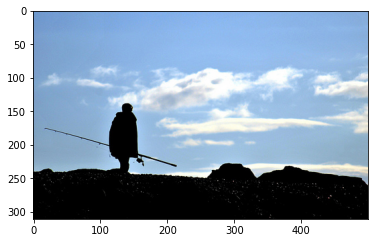

Real Caption: silhouette of man with fishing pole
Predicted Caption: man is standing on top of mountain
BLEU-1 score: 28.57142857142857
BLEU-2 score: 7.973301625706313e-153
BLEU-3 score: 1.7586776545063734e-183
BLEU-4 score: 1.331960397810445e-229


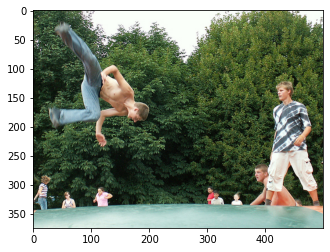

Real Caption: guy standing is watching another guy in midair
Predicted Caption: two boys jump into pool
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


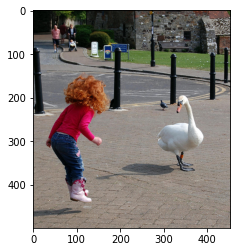

Real Caption: young red haired girl jumping on the sidewalk next to white duck
Predicted Caption: girl in pink dress is jumping in the air
BLEU-1 score: 23.88437701912631
BLEU-2 score: 6.17087516772532e-153
BLEU-3 score: 1.319791889377583e-183
BLEU-4 score: 9.918892480173173e-230


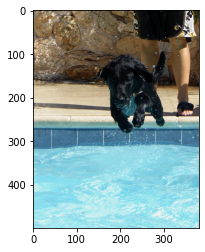

Real Caption: black dog jumps into swimming pool
Predicted Caption: black dog jumping into pool
BLEU-1 score: 65.49846024623855
BLEU-2 score: 36.61475238303926
BLEU-3 score: 2.556544942383951e-91
BLEU-4 score: 8.167155382413153e-153


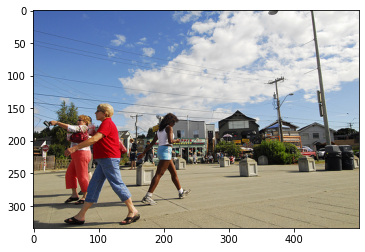

Real Caption: people walk outside on wooden walkway
Predicted Caption: people walking down the street
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230


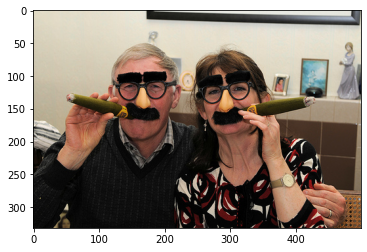

Real Caption: man and woman are dressed as groucho marx with fake cigars
Predicted Caption: two women pose for picture
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


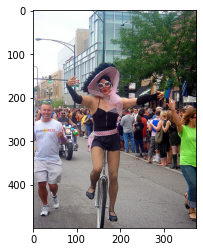

Real Caption: person is riding unicycle on the street with many other people around
Predicted Caption: man in red shirt is standing in front of crowd
BLEU-1 score: 8.18730753077982
BLEU-2 score: 3.862009336171134e-153
BLEU-3 score: 1.0508670198626023e-183
BLEU-4 score: 8.387826279040936e-230


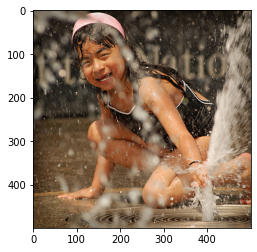

Real Caption: little girl crouches to splash fountain water
Predicted Caption: young boy wearing red swimsuit is splashing in water
BLEU-1 score: 11.111111111111109
BLEU-2 score: 4.972227154133551e-153
BLEU-3 score: 1.3247499323693867e-183
BLEU-4 score: 1.0518351895246306e-229


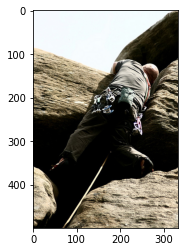

Real Caption: man in dark clothes appears to be climbing rocks
Predicted Caption: man is rock climbing on rocky mountain
BLEU-1 score: 21.470779802151025
BLEU-2 score: 5.991755122558557e-153
BLEU-3 score: 1.3216063232004421e-183
BLEU-4 score: 1.0009379942300741e-229


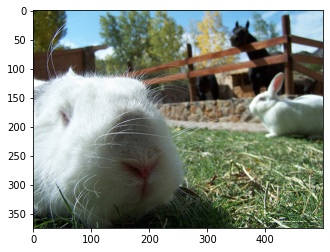

Real Caption: closeup of white bunny with another white bunny and black horse in the background
Predicted Caption: two dogs running through the grass
BLEU-1 score: 4.393285635262113
BLEU-2 score: 1.6052300505676238e-153
BLEU-3 score: 3.943682783790533e-184
BLEU-4 score: 3.0683945433989623e-230


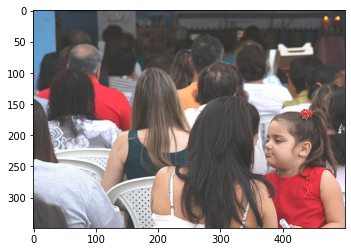

Real Caption: little girl looking into females face in the midst of crowd
Predicted Caption: group of people are posing for picture
BLEU-1 score: 8.06740174296799
BLEU-2 score: 3.183867019854334e-153
BLEU-3 score: 8.066942687669913e-184
BLEU-4 score: 6.325072941044999e-230


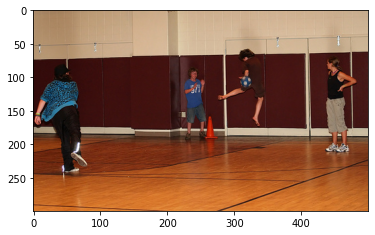

Real Caption: four people playing ball on court
Predicted Caption: group of people are playing basketball
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


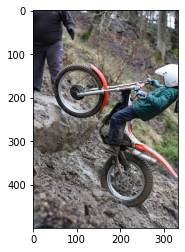

Real Caption: young child rides motorbike through the mud
Predicted Caption: man in red helmet and blue helmet is riding bike
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


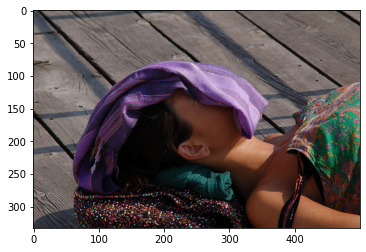

Real Caption: girl lays on wooden deck with piece of clothing covering her face
Predicted Caption: girl in pink shirt is holding camera
BLEU-1 score: 6.993452279385044
BLEU-2 score: 2.7600239552551947e-153
BLEU-3 score: 6.99305433449238e-184
BLEU-4 score: 5.483065946899793e-230


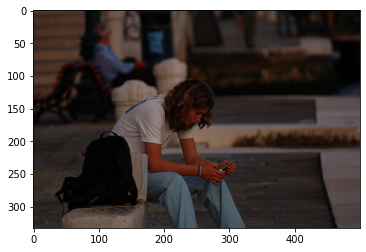

Real Caption: the young person <unk> his photos while sitting on bench
Predicted Caption: man and woman are sitting on concrete wall
BLEU-1 score: 19.470019576785123
BLEU-2 score: 14.717951377637847
BLEU-3 score: 1.4503816601791856e-91
BLEU-4 score: 5.050205928624139e-153


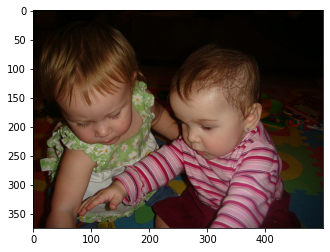

Real Caption: two babies are sitting close together while reaching for something
Predicted Caption: two young girls are smiling and one is holding naked
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


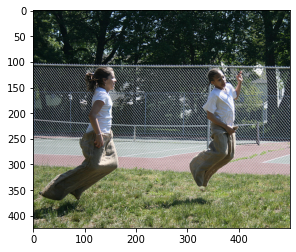

Real Caption: two girls hopping in potato sacks
Predicted Caption: two boys play in the grass
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


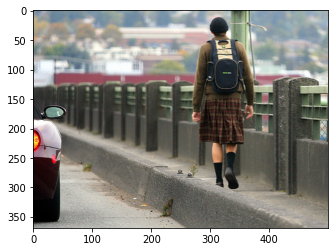

Real Caption: lone person wearing quilt walking along the sidewalk of street
Predicted Caption: woman in red jacket and blue jeans walks down the street
BLEU-1 score: 18.181818181818183
BLEU-2 score: 6.360494346864464e-153
BLEU-3 score: 1.5356698295026469e-183
BLEU-4 score: 1.1896457329133972e-229


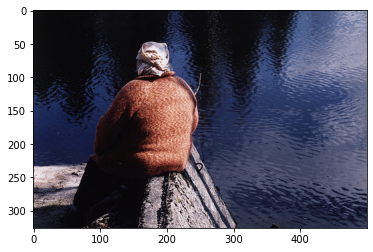

Real Caption: woman with sweater sits on sea wall and looks to the sea
Predicted Caption: the man is sitting on the shore of the water
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230


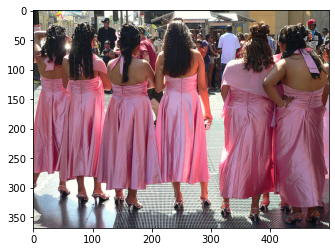

Real Caption: six women wearing <unk> pink dresses in front of crowd
Predicted Caption: group of people are standing in front of white flowers
BLEU-1 score: 30.0
BLEU-2 score: 25.819888974716104
BLEU-3 score: 23.781849487482358
BLEU-4 score: 3.6901226086395757e-76


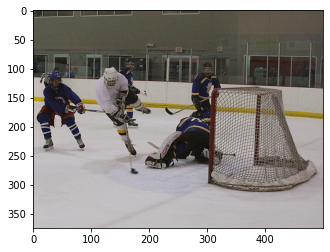

Real Caption: hockey game is being played
Predicted Caption: two men playing hockey on the ice
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


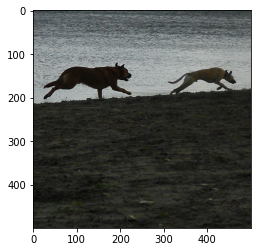

Real Caption: silhouette of two dogs running by lake
Predicted Caption: two dogs running through the water
BLEU-1 score: 42.324086244530704
BLEU-2 score: 37.855813571333776
BLEU-3 score: 34.45946953219957
BLEU-4 score: 4.888731610154635e-76


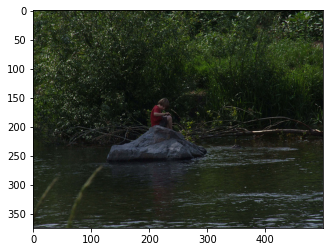

Real Caption: child wearing red shirt sits on rock in the water
Predicted Caption: man in red shirt is sitting on rock in the water
BLEU-1 score: 63.63636363636363
BLEU-2 score: 56.40760748177662
BLEU-3 score: 51.01128119150891
BLEU-4 score: 40.352786374639905


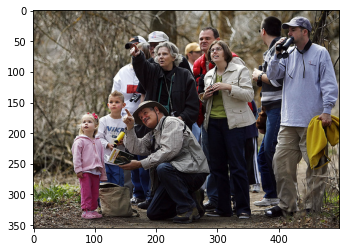

Real Caption: forest guide points something up to group of visitors
Predicted Caption: group of people are standing on the grass
BLEU-1 score: 22.062422564614888
BLEU-2 score: 16.677623835883093
BLEU-3 score: 1.6434977345885395e-91
BLEU-4 score: 5.722633035689358e-153


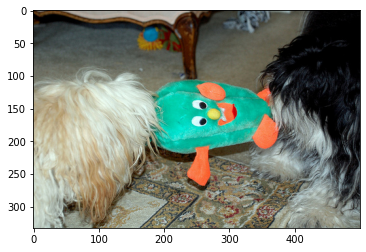

Real Caption: two dogs fight over green stuffed toy
Predicted Caption: two dogs playing with each other
BLEU-1 score: 28.2160574963538
BLEU-2 score: 21.856064155801842
BLEU-3 score: 1.9010499936561078e-91
BLEU-4 score: 6.416038883891965e-153


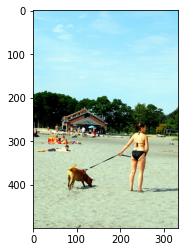

Real Caption: lone woman wearing bikini on beach walking dog on leash
Predicted Caption: woman and dog play with stick on the beach
BLEU-1 score: 39.77063630286087
BLEU-2 score: 8.898688699301466e-153
BLEU-3 score: 1.7967885069168788e-183
BLEU-4 score: 1.3310910140277609e-229


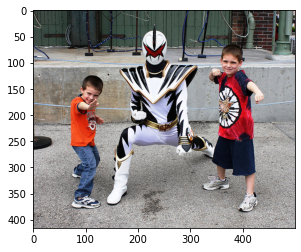

Real Caption: man in costume poses with two young boys
Predicted Caption: two children are playing in the street
BLEU-1 score: 24.767939992862335
BLEU-2 score: 6.911878967366998e-153
BLEU-3 score: 1.5245587914760605e-183
BLEU-4 score: 1.154647032204335e-229


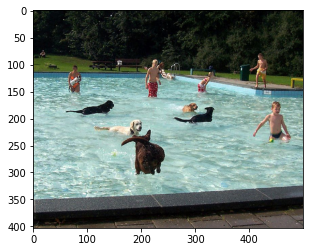

Real Caption: bunch of dogs and kids playing in swimming pool
Predicted Caption: group of children play in water
BLEU-1 score: 20.21768865708778
BLEU-2 score: 5.223533056060786e-153
BLEU-3 score: 1.117179715016979e-183
BLEU-4 score: 8.396161215621529e-230


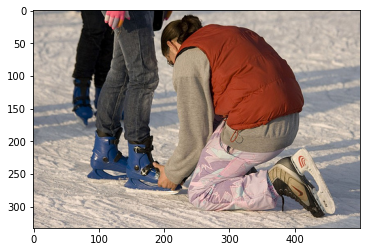

Real Caption: woman <unk> someone shoes
Predicted Caption: man and woman walk down snowy hill
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


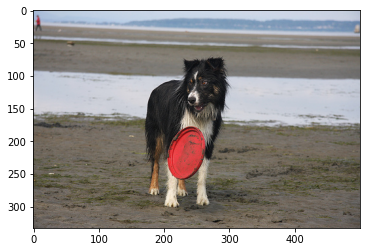

Real Caption: dog with red frisbee flying in the air
Predicted Caption: dog running on the beach
BLEU-1 score: 21.952465443761056
BLEU-2 score: 5.177564552024616e-153
BLEU-3 score: 1.0676968639301828e-183
BLEU-4 score: 7.951455490316087e-230


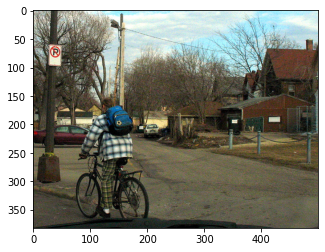

Real Caption: person wearing blue and white coat rides bicycle down the street
Predicted Caption: man rides bike down the road
BLEU-1 score: 21.729910425353914
BLEU-2 score: 13.743202059111331
BLEU-3 score: 1.1022783086561772e-91
BLEU-4 score: 3.645525559050358e-153


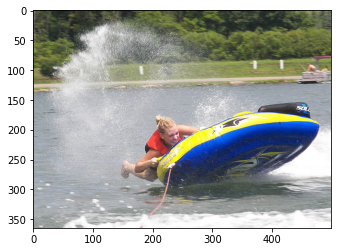

Real Caption: woman rides an inflatable tube pulled by boat
Predicted Caption: man in blue life jacket is riding blue surfboard
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


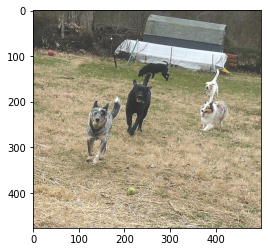

Real Caption: four dogs run toward tennis ball while another stands in the background
Predicted Caption: two dogs play in the grass
BLEU-1 score: 18.393972058572118
BLEU-2 score: 11.633369384516797
BLEU-3 score: 9.330584440207895e-92
BLEU-4 score: 3.0858707633577667e-153


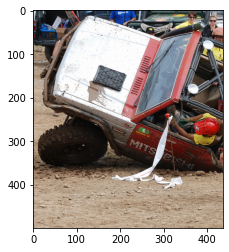

Real Caption: red car has rolled over on dirt track
Predicted Caption: blue and white car is driving on dirt track
BLEU-1 score: 44.44444444444444
BLEU-2 score: 33.333333333333336
BLEU-3 score: 28.853455719062136
BLEU-4 score: 4.335118471269586e-76


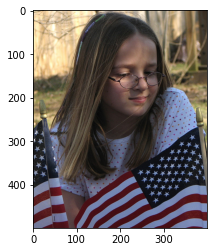

Real Caption: girl in glasses is looking over two american flags near wooded area
Predicted Caption: girl in pink shirt is blowing bubbles
BLEU-1 score: 20.980356838155135
BLEU-2 score: 13.083551190106055
BLEU-3 score: 1.1224178752497289e-91
BLEU-4 score: 3.7751121892103357e-153


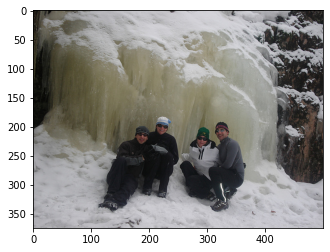

Real Caption: two couples pose for picture in the winter
Predicted Caption: two people are standing on rocky mountain
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


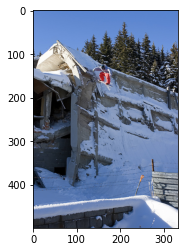

Real Caption: someone is off the top of some type of building
Predicted Caption: man in red pants is jumping off of cliff
BLEU-1 score: 29.827977227145652
BLEU-2 score: 7.70649047396433e-153
BLEU-3 score: 1.6482206083667876e-183
BLEU-4 score: 1.2387197655613556e-229


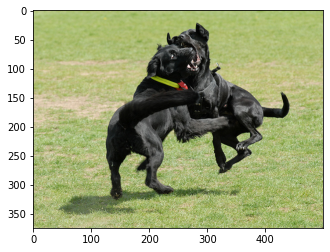

Real Caption: two black dogs fight in field
Predicted Caption: two black dogs running through grass
BLEU-1 score: 50.0
BLEU-2 score: 44.721359549995796
BLEU-3 score: 40.70905315369044
BLEU-4 score: 5.775353993361614e-76


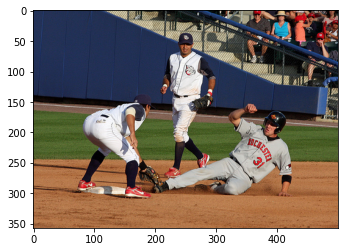

Real Caption: baseball player slides toward base
Predicted Caption: baseball player slides into home
BLEU-1 score: 60.0
BLEU-2 score: 54.77225575051662
BLEU-3 score: 50.11872336272722
BLEU-4 score: 6.86809206056511e-76


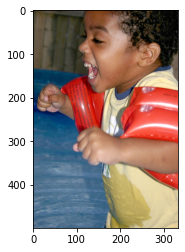

Real Caption: the little boy is wading through the pool with red arm floaties
Predicted Caption: young boy wearing red shirt and red swim trunks is smiling whilst smiling
BLEU-1 score: 23.076923076923077
BLEU-2 score: 7.165741990418252e-153
BLEU-3 score: 1.6495292825393885e-183
BLEU-4 score: 1.2627076138080563e-229


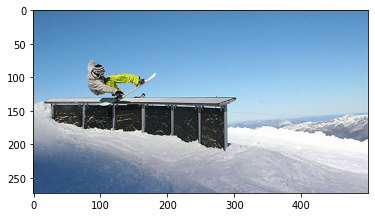

Real Caption: the man is performing trick on snowboard high in the air
Predicted Caption: snowboarder is jumping off of high high high high high high in the air
BLEU-1 score: 35.71428571428572
BLEU-2 score: 28.70846258816073
BLEU-3 score: 27.628708617572773
BLEU-4 score: 18.798317647335086


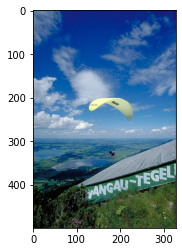

Real Caption: hang glider floating through the air above many green trees
Predicted Caption: person is hang gliding in the air
BLEU-1 score: 27.91881675133095
BLEU-2 score: 17.410441154600917
BLEU-3 score: 1.493615157227752e-91
BLEU-4 score: 5.023587836914362e-153


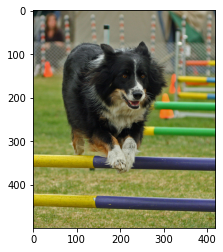

Real Caption: small black dog jumping over gates
Predicted Caption: dog jumping over hurdle
BLEU-1 score: 45.48979947844751
BLEU-2 score: 42.88819424803534
BLEU-3 score: 40.01610018085611
BLEU-4 score: 5.238101011110965e-76


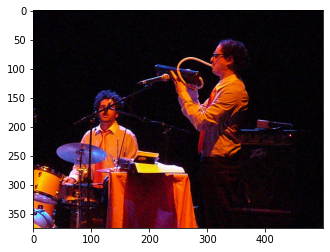

Real Caption: man plays an instrument next to drummer
Predicted Caption: man in red shirt plays guitar while another man watches
BLEU-1 score: 20.0
BLEU-2 score: 6.6709427497276e-153
BLEU-3 score: 1.5802130991274055e-183
BLEU-4 score: 1.2183324802375697e-229


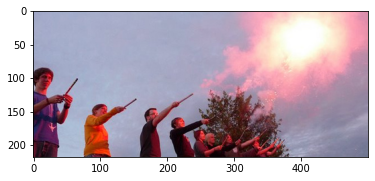

Real Caption: people play with pyrotechnics
Predicted Caption: group of people are standing in front of large crowd
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


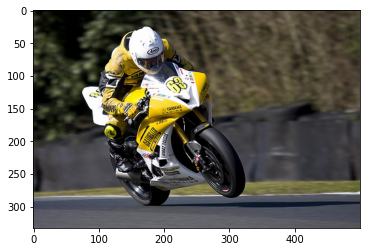

Real Caption: motorcyclist in yellow and white rides his bike
Predicted Caption: man in red and black and red helmet is riding red motorcycle
BLEU-1 score: 16.666666666666668
BLEU-2 score: 6.08970970641905e-153
BLEU-3 score: 1.4961022763680928e-183
BLEU-4 score: 1.1640469867513693e-229


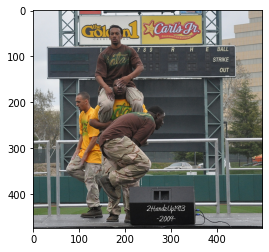

Real Caption: man gives another man piggy back ride
Predicted Caption: two men are playing in martial arts
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


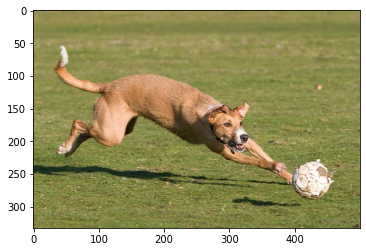

Real Caption: brown dog is chasing tattered soccer ball across low cut field
Predicted Caption: brown dog is chasing brown dog
BLEU-1 score: 28.973213900471883
BLEU-2 score: 27.48640411822266
BLEU-3 score: 26.81618113263186
BLEU-4 score: 22.083358203177394


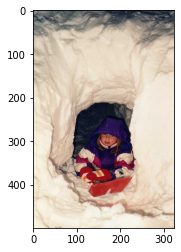

Real Caption: the girl in the purple jacket is laying in hole that has been dug out of the snow
Predicted Caption: child in red jacket is laying in the snow
BLEU-1 score: 28.612845424445517
BLEU-2 score: 25.649168584319987
BLEU-3 score: 20.34725224958384
BLEU-4 score: 14.3494277329798


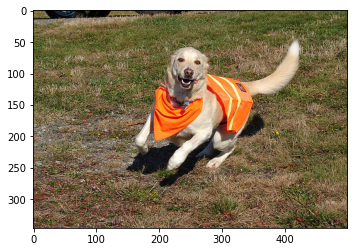

Real Caption: dog wearing orange plays in the grass
Predicted Caption: brown dog running through grass
BLEU-1 score: 26.812801841425575
BLEU-2 score: 6.32389162439519e-153
BLEU-3 score: 1.304087894483289e-183
BLEU-4 score: 9.711929667259894e-230


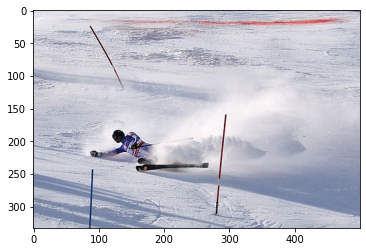

Real Caption: downhill slalom skier leaning through turn
Predicted Caption: skier is skiing downhill on mountain
BLEU-1 score: 33.33333333333333
BLEU-2 score: 8.612150057732662e-153
BLEU-3 score: 1.8419179593432007e-183
BLEU-4 score: 1.384292958842266e-229


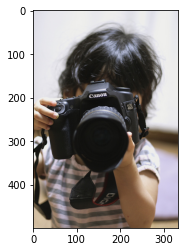

Real Caption: the person is holding canon camera
Predicted Caption: young boy with his face painted camera
BLEU-1 score: 14.285714285714285
BLEU-2 score: 5.637975647982814e-153
BLEU-3 score: 1.4284901392909564e-183
BLEU-4 score: 1.1200407237786664e-229


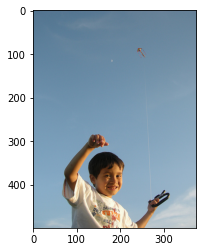

Real Caption: boy flying distant kite
Predicted Caption: person is suspended above the head
BLEU-1 score: 0
BLEU-2 score: 0
BLEU-3 score: 0
BLEU-4 score: 0


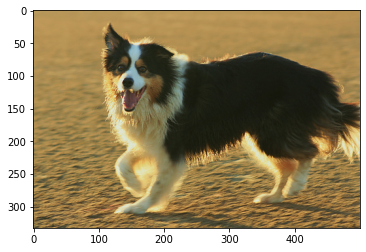

Real Caption: puppy runs in the sand
Predicted Caption: black and white dog running on the grass
BLEU-1 score: 12.500000000000004
BLEU-2 score: 5.273843307431706e-153
BLEU-3 score: 1.372396692566494e-183
BLEU-4 score: 1.0832677820940878e-229


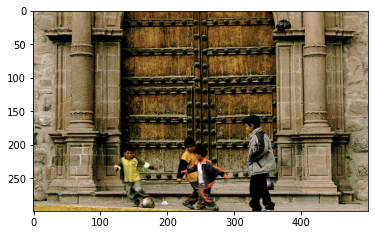

Real Caption: the four children are playing with ball outside building
Predicted Caption: group of people stand in front of large brick building
BLEU-1 score: 10.000000000000002
BLEU-2 score: 4.717068855239749e-153
BLEU-3 score: 1.2835318765197404e-183
BLEU-4 score: 1.0244914152188952e-229


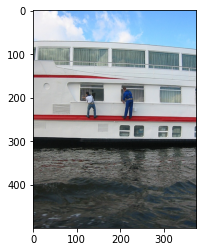

Real Caption: two people stand on the side of large white and red boat
Predicted Caption: two men in blue life jackets on raft in the water
BLEU-1 score: 24.902746807698065
BLEU-2 score: 7.113038902664186e-153
BLEU-3 score: 1.5835942390985683e-183
BLEU-4 score: 1.2021513525930774e-229


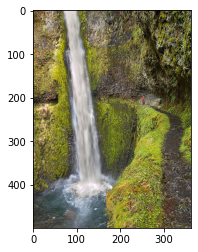

Real Caption: beautiful waterfall flows down the side of mossy rock wall
Predicted Caption: kayaker is paddling huge waterfall
BLEU-1 score: 7.357588823428847
BLEU-2 score: 2.454102690856474e-153
BLEU-3 score: 5.813279118387829e-184
BLEU-4 score: 4.481994719908145e-230


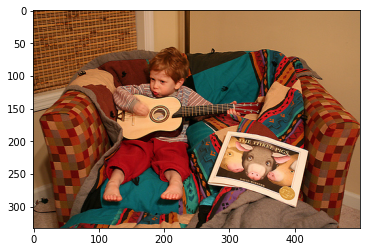

Real Caption: young barefoot boy playing guitar setting in large <unk> colored chair with picture of three <unk> beside him
Predicted Caption: two babies are playing with toys
BLEU-1 score: 4.511176107887089
BLEU-2 score: 1.1655277673394603e-153
BLEU-3 score: 2.4927648872631574e-184
BLEU-4 score: 1.8734367966736672e-230


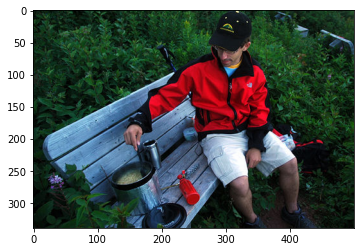

Real Caption: man wearing red jacket is sitting on wooden bench and is cooking something in small pot
Predicted Caption: man and woman are sitting on bench
BLEU-1 score: 19.74664618782603
BLEU-2 score: 9.538536312716417
BLEU-3 score: 7.388238798462879e-92
BLEU-4 score: 2.422276827743267e-153


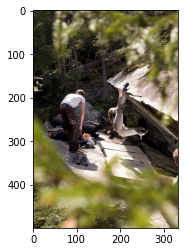

Real Caption: two people climbing some sort of object in the distance
Predicted Caption: young boy is jumping over pile of leaves
BLEU-1 score: 9.735009788392563
BLEU-2 score: 4.1072732976237013e-153
BLEU-3 score: 1.0688236188553917e-183
BLEU-4 score: 8.436497969708995e-230


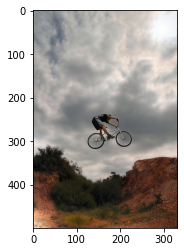

Real Caption: man on bike in midair
Predicted Caption: man in blue and yellow is doing tricks on bike
BLEU-1 score: 40.0
BLEU-2 score: 21.08185106778919
BLEU-3 score: 1.9886052149911738e-91
BLEU-4 score: 6.848990852664275e-153


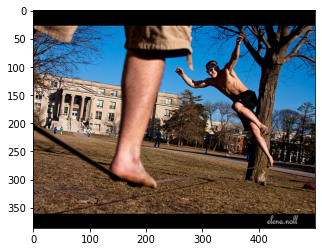

Real Caption: man in swimsuit walks on tightrope
Predicted Caption: two boys play in sprinkler
BLEU-1 score: 16.374615061559638
BLEU-2 score: 5.461705981224581e-153
BLEU-3 score: 1.2937690606722724e-183
BLEU-4 score: 9.97486269044271e-230


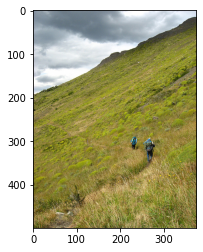

Real Caption: two mountain climbers climbing up large grassy mountain
Predicted Caption: two dogs running through field
BLEU-1 score: 10.976232721880528
BLEU-2 score: 3.6610910047675876e-153
BLEU-3 score: 8.672393363093234e-184
BLEU-4 score: 6.686350417856737e-230


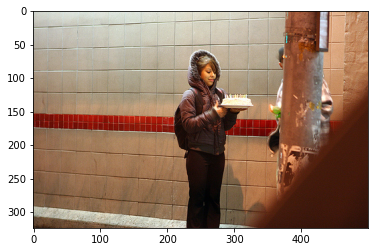

Real Caption: girl in hooded jacket presents cake with candles
Predicted Caption: two women stand in front of store
BLEU-1 score: 12.383969996431167
BLEU-2 score: 4.887436488566011e-153
BLEU-3 score: 1.2383265317623888e-183
BLEU-4 score: 9.709385502639236e-230


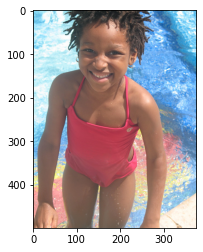

Real Caption: young girl in red bathing suit at the edge of the pool
Predicted Caption: girl in bathing suit laughs
BLEU-1 score: 19.72775711532852
BLEU-2 score: 15.59616140275779
BLEU-3 score: 9.480015603447124e-92
BLEU-4 score: 2.9253304977262826e-153


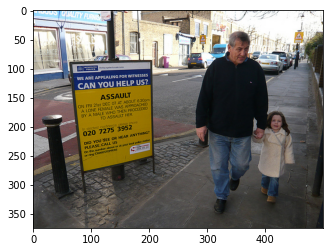

Real Caption: man and girl hold hands walking down the street
Predicted Caption: man walks down the sidewalk
BLEU-1 score: 26.959737847033296
BLEU-2 score: 17.40243594994629
BLEU-3 score: 1.287049118889832e-91
BLEU-4 score: 4.1711849316776385e-153


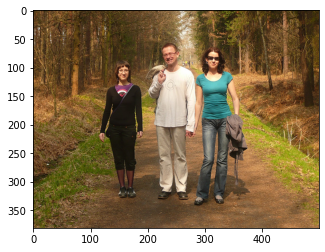

Real Caption: two women and man posing on rural path
Predicted Caption: two women walking through forest
BLEU-1 score: 21.952465443761056
BLEU-2 score: 17.35494776460598
BLEU-3 score: 1.3919596311329484e-91
BLEU-4 score: 4.6035782185062355e-153
BLEU-1 count: 188
BLEU-2 count: 70
BLEU-3 count: 25
BLEU-4 count: 7
BLEU-1 Total: 48.51672422319025
BLEU-2 Total: 18.362441596771827
BLEU-3 Total: 8.260604657280972
BLEU-4 Total: 1.93958186752385
BLEU-1 Average: 0.25806768203824604
BLEU-2 Average: 0.2623205942395975
BLEU-3 Average: 0.3304241862912389
BLEU-4 Average: 0.2770831239319786


'\nprint(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")\nprint(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")\nprint(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")\nprint(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")\n'

In [ ]:
blue_1 = 0
blue_2 = 0
blue_3 = 0
blue_4 = 0
blue_count_1 = 0
blue_count_2 = 0
blue_count_3 = 0
blue_count_4 = 0
for j in range(250):
    start_token = tokenizer.word_index['<start>']
    end_token = tokenizer.word_index['<end>']
    # select random image from validation data
    rid = np.random.randint(0, len(img_name_val))
    image = img_name_val[rid]
    temp_image = np.array(Image.open(image))
    plt.imshow(temp_image)
    plt.show()
    real_caption = ' '.join([tokenizer.index_word[i] for i in cap_val[rid] if i not in [0]])
    caption,result,attention_weights = evaluate(image)
    first = real_caption.split(' ', 1)[1]
    real_caption = first.rsplit(' ', 1)[0]

    #remove "<unk>" in result
    for i in caption:
        if i=="<unk>":
            caption.remove(i)

    for i in real_caption:
        if i=="<unk>":
            real_caption.remove(i)

    #remove <end> from result         
    result_join = ' '.join(caption)
    result_final = result_join.rsplit(' ', 1)[0]

    real_appn = []
    real_appn.append(real_caption.split())
    reference = real_appn
    candidate = caption
    print ('Real Caption:', real_caption)
    print ('Predicted Caption:', ' '.join(caption))
    score = sentence_bleu(reference, candidate, weights=(1.0,0,0,0))
    if score > 0.1:
        blue_1 +=score
        blue_count_1 +=1
    print(f"BLEU-1 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.5,0.5,0,0))
    if score > 0.1:
        blue_2 +=score
        blue_count_2 +=1
    print(f"BLEU-2 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.3,0.3,0.3,0))
    if score > 0.1:
        blue_3 +=score
        blue_count_3 += 1
    print(f"BLEU-3 score: {score*100}")
    score = sentence_bleu(reference, candidate, weights=(0.25,0.25,0.25,0.25))
    if score > 0.1:
        blue_4 +=score
        blue_count_4 += 1
    print(f"BLEU-4 score: {score*100}")

print(f"BLEU-1 count: {blue_count_1}")
print(f"BLEU-2 count: {blue_count_2}")
print(f"BLEU-3 count: {blue_count_3}")
print(f"BLEU-4 count: {blue_count_4}")
print(f"BLEU-1 Total: {blue_1}")
print(f"BLEU-2 Total: {blue_2}")
print(f"BLEU-3 Total: {blue_3}")
print(f"BLEU-4 Total: {blue_4}")
if blue_count_1 > 0:
    print(f"BLEU-1 Average: {blue_1/blue_count_1}")
if blue_count_2 > 0:
    print(f"BLEU-2 Average: {blue_2/blue_count_2}")
if blue_count_3 > 0:
    print(f"BLEU-3 Average: {blue_3/blue_count_3}")
if blue_count_4 > 0:
    print(f"BLEU-4 Average: {blue_4/blue_count_4}")
"""
print(f"BLEU-1 count: {blue_count_1}", f"BLEU-1 Average: {blue_1/blue_count_1}")
print(f"BLEU-1 count: {blue_count_2}",f"BLEU-1 Average: {blue_2/blue_count_2}")
print(f"BLEU-1 count: {blue_count_3}",f"BLEU-1 Average: {blue_3/blue_count_3}")
print(f"BLEU-1 count: {blue_count_4}",f"BLEU-1 Average: {blue_4/blue_count_4}")
"""